<a href="https://colab.research.google.com/github/ernesto-miguez/Machine-Learning-training/blob/master/AI_Scientific_Problems.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%tensorflow_version 2.x

In [ ]:
import tensorflow as tf

In [ ]:
print("GPU Available: ", tf.config.list_physical_devices('GPU'))

GPU Available:  [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [ ]:
print(tf.__version__)

2.2.0


## Keras in Colab

In [ ]:
from tensorflow import keras

In [ ]:
print(tf.keras.__version__)

2.3.0-tf


## Práctica 1: "Hello World en Deep Learning"


In [ ]:
%tensorflow_version 2.x

import tensorflow as tf
from tensorflow import keras

import numpy as np
import matplotlib.pyplot as plt

print(tf.__version__)

2.2.0


In [ ]:
mnist = keras.datasets.mnist

(x_train, y_train), (x_test, y_test) = mnist.load_data()

11493376/11490434 [==============================] - 0s 0us/step


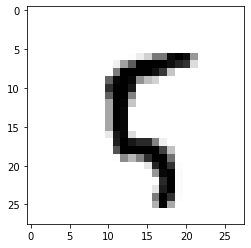

In [ ]:
plt.imshow(x_train[100], cmap=plt.cm.binary)

In [ ]:
np.set_printoptions(precision=2, suppress=True, linewidth=120)
print(np.matrix(x_train[100]))

[[  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0   0   0   0   2  18  46 136 136 244 255 241 103   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0   0  15  94 163 253 253 253 253 238 218 204  35   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0   0 131 253 253 253 253 237 200  57   

### Comprobación de los datos cargados

In [ ]:
print(y_train[1])
print(x_train.ndim)
print(x_train.shape)

0
3
(60000, 28, 28)


### Preprocesado

In [ ]:
# Conversión de int a float32
x_train = x_train.astype('float32')
x_test = x_test.astype('float32')

# Normalización a 1 para facilitar convergencia
x_train /= 255
x_test /= 255

In [ ]:
np.set_printoptions(precision=2, linewidth=150, suppress=True)
print(np.matrix(x_train[100]))

[[0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.01 0.07 0.18 0.53 0.53 0.96 1.   0.95 0.4  0.   0.   0.   0.   0.   0.  ]

### Preprocesando datos de entrada

In [ ]:
x_train = x_train.reshape(60000, 784)
x_test = x_test.reshape(10000, 784)

print(x_train.shape)
print(x_test.shape)

(60000, 784)
(10000, 784)


## Aplicación de one-hot encoding

In [ ]:
from tensorflow.keras.utils import to_categorical

print(y_test[0])

y_train = to_categorical(y_train, num_classes=10)
y_test = to_categorical(y_test, num_classes=10)
print(y_test[0])

7
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]


### 1.1 Definición del modelo

In [ ]:
from keras.models import Sequential
from keras.layers import Dense, Activation

model = Sequential()
model.add(Dense(10, activation='sigmoid', input_shape=(784, )))
model.add(Dense(10, activation='softmax'))

Using TensorFlow backend.


In [ ]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 10)                7850      
_________________________________________________________________
dense_2 (Dense)              (None, 10)                110       
Total params: 7,960
Trainable params: 7,960
Non-trainable params: 0
_________________________________________________________________


### 1.2 Configuración del modelo de aprendizaje

In [ ]:
model.compile(optimizer='sgd',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

### 1.3 Entrenamiento del modelo

In [ ]:
model.fit(x_train, y_train, epochs=5)

Epoch 1/5
60000/60000 [==============================] - 8s 126us/step - loss: 1.9179 - accuracy: 0.4934
Epoch 2/5
60000/60000 [==============================] - 6s 97us/step - loss: 1.3183 - accuracy: 0.7197
Epoch 3/5
60000/60000 [==============================] - 6s 95us/step - loss: 1.0061 - accuracy: 0.7760
Epoch 4/5
60000/60000 [==============================] - 6s 96us/step - loss: 0.8282 - accuracy: 0.8136
Epoch 5/5
60000/60000 [==============================] - 6s 97us/step - loss: 0.7109 - accuracy: 0.8411


### 1.4 Evaluación del modelo

In [ ]:
test_loss, test_acc = model.evaluate(x_test, y_test)

10000/10000 [==============================] - 1s 76us/step


In [ ]:
print("Test accuracy:", test_acc)

Test accuracy 0.8598999977111816


In [ ]:
# Importar librerías necesarias
from collections import Counter
from sklearn.metrics import confusion_matrix
import itertools


# Generate confussion matrix

def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
  
  plt.imshow(cm, interpolation='nearest', cmap=cmap)
  plt.title(title)
  plt.colorbar()
  tick_marks = np.arange(len(classes))
  plt.xticks(tick_marks, classes, rotation=45)
  plt.yticks(tick_marks, classes)

  if normalize:
    cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

  thresh = cm.max() / 2.
  for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
    plt.text(j, i, cm[i,j],
             horizontalalignment="center",
             color="white" if cm[i,j] > thresh else "black")
    
    plt.tight_layout()
    plt.ylabel('Observación')
    plt.xlabel('Predicción')

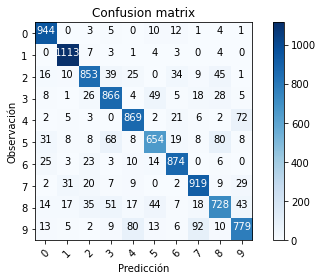

In [ ]:
# Predecir los valors de dataset de validation
Y_pred = model.predict(x_test)
# Convertir las predicciones de clases a vectores one-hot
Y_pred_classes = np.argmax(Y_pred, axis=1)
# Convertir las observaciones de validation a vectores one-hot
Y_true = np.argmax(y_test, axis=1)
# Crear matriz de confusión
confusion_mtx = confusion_matrix(Y_true, Y_pred_classes)
# Pintar matriz de confusión
plot_confusion_matrix(confusion_mtx, classes=range(10))

### 1.5 Generación de predicciones

In [ ]:
x_test.shape

(10000, 784)

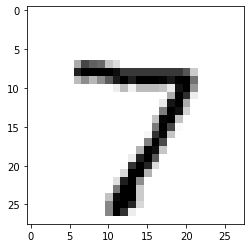

In [ ]:
plt.imshow(x_test.reshape(10000, 28, 28)[0], cmap=plt.cm.binary)

In [ ]:
predictions = model.predict(x_test)

np.argmax(predictions[0])

7

In [ ]:
np.set_printoptions(precision=8, linewidth=60)
predictions[0]

array([0.00811908, 0.0115344 , 0.00165917, 0.03070811,
       0.01168   , 0.02178641, 0.01105813, 0.8563607 ,
       0.00618932, 0.04090466], dtype=float32)

## Práctica 2: "Implementación de una CNN para la base de datos MNIST"

### 2.1 Definición del modelo

In [ ]:
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import MaxPooling2D

model_1 = Sequential()
model_1.add(Conv2D(32, (5,5), activation='relu', input_shape=(28,28,1)))
model_1.add(MaxPooling2D((2,2)))
model_1.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_3 (Conv2D)            (None, 24, 24, 32)        832       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 12, 12, 32)        0         
Total params: 832
Trainable params: 832
Non-trainable params: 0
_________________________________________________________________


In [ ]:
model_1.add(Conv2D(64, (5,5), activation='relu'))
model_1.add(MaxPooling2D((2,2)))
model_1.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_3 (Conv2D)            (None, 24, 24, 32)        832       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 12, 12, 32)        0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 8, 8, 64)          51264     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 4, 4, 64)          0         
Total params: 52,096
Trainable params: 52,096
Non-trainable params: 0
_________________________________________________________________


In [ ]:
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Flatten

model_1.add(Flatten())
model_1.add(Dense(10, activation='softmax'))
model_1.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_3 (Conv2D)            (None, 24, 24, 32)        832       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 12, 12, 32)        0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 8, 8, 64)          51264     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 4, 4, 64)          0         
_________________________________________________________________
flatten (Flatten)            (None, 1024)              0         
_________________________________________________________________
dense (Dense)                (None, 10)                10250     
Total params: 62,346
Trainable params: 62,346
Non-trainable params: 0
__________________________________________________

### 2.2 Preprocesamiento de los datos

In [ ]:
print(x_train.shape)
print(y_train.shape)
train_images = x_train.reshape((60000, 28, 28, 1))

test_images = x_test.reshape((10000, 28, 28, 1))

train_labels =  y_train.copy()
test_labels = y_test.copy()

print(train_images.shape)
print(train_labels.shape)

(60000, 784)
(60000, 10)
(60000, 28, 28, 1)
(60000, 10)


### 2.3 Configuración del modelo de aprendizaje

In [ ]:
model_1.compile(loss='categorical_crossentropy',
                optimizer='sgd',
                metrics=['accuracy'])

### Entrenamiento del modelo

In [ ]:
model_1.fit(train_images, train_labels, 
            batch_size = 100,
            epochs=5,
            verbose=1)

Epoch 1/5
600/600 [==============================] - 5s 8ms/step - loss: 0.8449 - accuracy: 0.8031
Epoch 2/5
600/600 [==============================] - 4s 7ms/step - loss: 0.2464 - accuracy: 0.9287
Epoch 3/5
600/600 [==============================] - 4s 7ms/step - loss: 0.1793 - accuracy: 0.9484
Epoch 4/5
600/600 [==============================] - 4s 7ms/step - loss: 0.1446 - accuracy: 0.9591
Epoch 5/5
600/600 [==============================] - 4s 7ms/step - loss: 0.1230 - accuracy: 0.9643


### 2.4 Validación del modelo

In [ ]:
test_loss, test_acc = model_1.evaluate(test_images, test_labels)

print('Test Accuracy:', test_acc)

313/313 [==============================] - 1s 4ms/step - loss: 0.1018 - accuracy: 0.9695
Test Accuracy: 0.9695000052452087


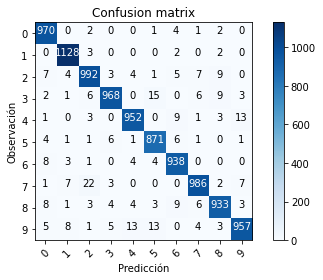

In [ ]:
# Predecir los valors de dataset de validation
Y_pred = model_1.predict(test_images)
# Convertir las predicciones de clases a vectores one-hot
Y_pred_classes = np.argmax(Y_pred, axis=1)
# Convertir las observaciones de validation a vectores one-hot
Y_true = np.argmax(test_labels, axis=1)
# Crear matriz de confusión
confusion_mtx = confusion_matrix(Y_true, Y_pred_classes)
# Pintar matriz de confusión
plot_confusion_matrix(confusion_mtx, classes=range(10))

### 2.5 Generación de predicciones

In [ ]:
test_images.shape

(10000, 28, 28, 1)

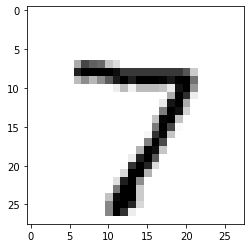

In [ ]:
plt.imshow(test_images.reshape(10000, 28, 28)[0], cmap=plt.cm.binary)

In [ ]:
predictions = model_1.predict(test_images)

np.argmax(predictions[0])

7

In [ ]:
predictions[0]

array([0.00000015, 0.00000005, 0.000007  , 0.00000939,
       0.        , 0.0000002 , 0.        , 0.9999708 ,
       0.00000018, 0.00001226], dtype=float32)

## Práctica 3: GANs

In [1]:
%tensorflow_version 2.x
import tensorflow as tf
from tensorflow import keras
print(tf.__version__)

2.2.0


In [2]:
!nvidia-smi

Fri Jul 17 22:00:58 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.51.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P8     7W /  75W |      0MiB /  7611MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [3]:
import imageio
import matplotlib.pyplot as plt
import numpy as np
import os

In [4]:
(train_images, _), (_, _) = tf.keras.datasets.mnist.load_data()

train_images = train_images.reshape(train_images.shape[0], 28, 28, 1).astype('float32')

train_images = (train_images - 127.5) / 127.5

BUFFER_SIZE = 60000
BATCH_SIZE = 256
train_dataset = tf.data.Dataset.from_tensor_slices(train_images).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

11493376/11490434 [==============================] - 0s 0us/step


### 3.1 Modelos

#### 3.1.1 Generador

In [7]:
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, Reshape, Conv2DTranspose, BatchNormalization, LeakyReLU

def make_generator_model():
  model = Sequential()
  model.add(Dense(7*7*256, use_bias=False, input_shape=(100,)))
  
  model.add(Reshape((7,7,256)))

  model.add(Conv2DTranspose(128, (5,5), strides=(2,2), padding='same'))
  model.add(BatchNormalization())
  model.add(LeakyReLU(alpha=0.01))

  model.add(Conv2DTranspose(64, (5,5), strides=(1,1), padding='same'))
  model.add(BatchNormalization())
  model.add(LeakyReLU(alpha=0.01))

  model.add(Conv2DTranspose(1, (5,5), strides=(2,2), padding='same', activation='tanh'))

  return model

In [8]:
generator = make_generator_model()
generator.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 12544)             1254400   
_________________________________________________________________
reshape (Reshape)            (None, 7, 7, 256)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 14, 14, 128)       819328    
_________________________________________________________________
batch_normalization (BatchNo (None, 14, 14, 128)       512       
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 14, 14, 128)       0         
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 14, 14, 64)        204864    
_________________________________________________________________
batch_normalization_1 (Batch (None, 14, 14, 64)        2

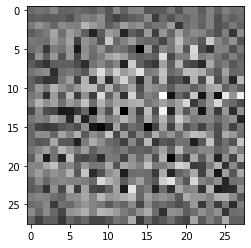

In [9]:
noise_dim = 100
noise = tf.random.normal((1, noise_dim))
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0,:, :, 0], cmap='gray')

#### 3.1.2 Discriminador

In [11]:
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, Flatten, BatchNormalization, LeakyReLU, Conv2D

def make_discriminator_model():
  model = Sequential()
  model.add(Conv2D(32, (5,5), strides=(2,2), padding='same', input_shape=(28,28,1)))

  model.add(LeakyReLU(alpha=0.01))

  model.add(Conv2D(64, (5,5), strides=(2,2), padding='same'))
  model.add(BatchNormalization())
  model.add(LeakyReLU(alpha=0.01))

  model.add(Conv2D(128, (5,5), strides=(2,2), padding='same'))
  model.add(BatchNormalization())
  model.add(LeakyReLU(alpha=0.01))

  model.add(Flatten())
  model.add(Dense(1, activation='sigmoid'))

  return model

In [12]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print(decision)

discriminator.summary()

tf.Tensor([[0.5003797]], shape=(1, 1), dtype=float32)
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 14, 14, 32)        832       
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 14, 14, 32)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 7, 7, 64)          51264     
_________________________________________________________________
batch_normalization_2 (Batch (None, 7, 7, 64)          256       
_________________________________________________________________
leaky_re_lu_3 (LeakyReLU)    (None, 7, 7, 64)          0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 4, 4, 128)         204928    
_________________________________________________________________


### 3.2 Funciones de Loss y optimizadores

In [14]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

#### 3.2.1 Discriminator loss

In [15]:
def discriminator_loss(real_output, fake_output):
  real_loss = cross_entropy(tf.ones_like(real_output), real_output)
  fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
  total_loss = real_loss + fake_loss
  return total_loss  

#### 3.2.2 Generator loss

In [16]:
def generator_loss(fake_output):
  return cross_entropy(tf.ones_like(fake_output), fake_output)

#### 3.2.3 Optimizadores

In [17]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)

discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

### 3.3 Entrenamiento

#### 3.3.1 Training Step

In [26]:
@tf.function
def train_step(images):
  noise = tf.random.normal((BATCH_SIZE, noise_dim))

  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(noise, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

#### 3.3.2 Training Loop

In [28]:
import time

grid_size_x = 10
grid_size_y = 10
seed = tf.random.normal([grid_size_x*grid_size_y, noise_dim])

def train(dataset, epochs):
  for epoch in range(epochs):
    start = time.time()

    for image_batch in dataset:
      train_step(image_batch)

    generate_images(generator, seed)
    print('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))
  
  generate_images(geneerator, seed)

#### 3.3.3 Visualización de las imágenes (solo las que genera el Generador para ver que va aprendiendo)

In [24]:
def generate_images(model, test_input):

  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(grid_size_x, grid_size_y))
  for i in range(predictions.shape[0]):
    plt.subplot(grid_size_x, grid_size_y, i+1)
    plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
    plt.axis('off')
  plt.show()

#### 3.3.4 Entrenar el modelo

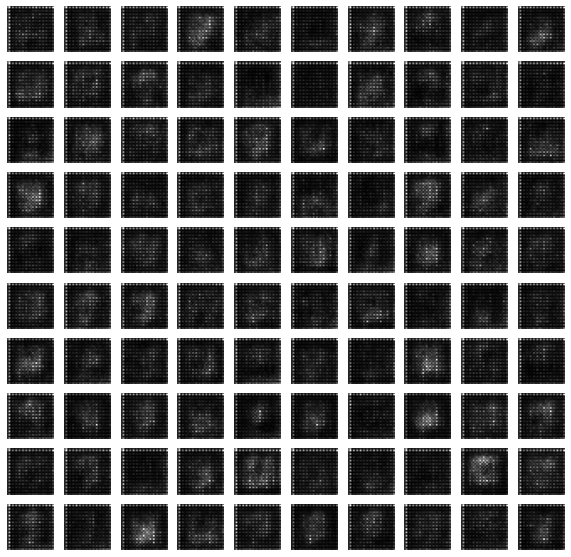

Time for epoch 1 is 19.06481170654297 sec


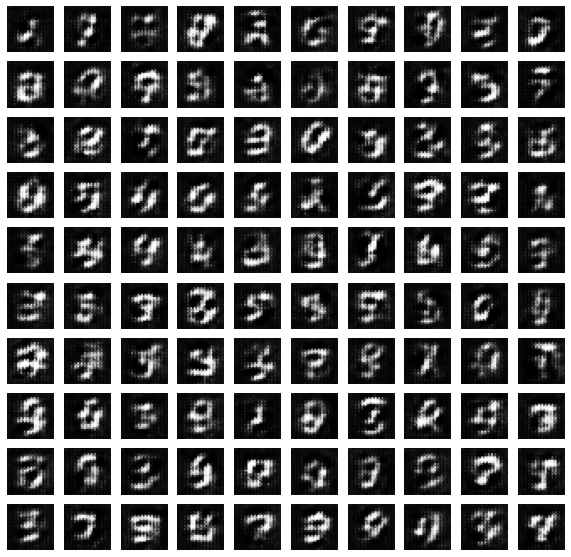

Time for epoch 2 is 16.896249771118164 sec


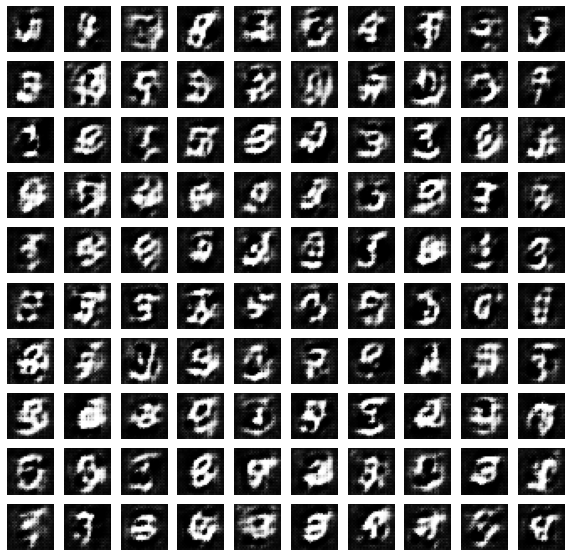

Time for epoch 3 is 17.062450885772705 sec


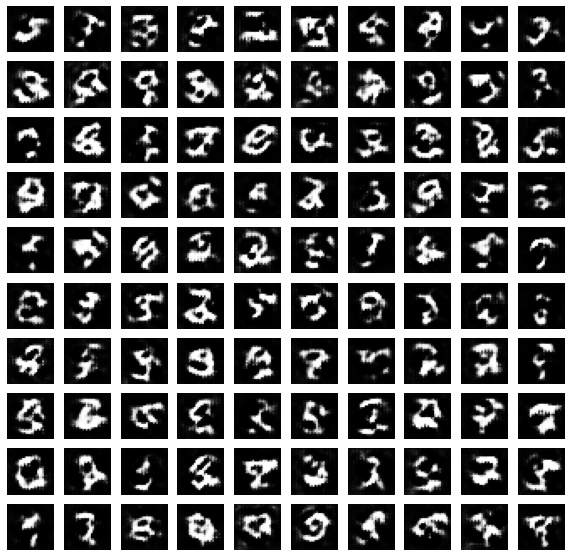

Time for epoch 4 is 16.82726240158081 sec


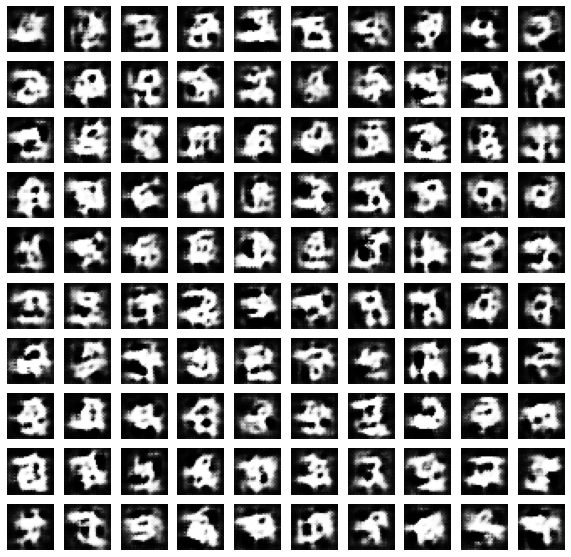

Time for epoch 5 is 17.000617742538452 sec


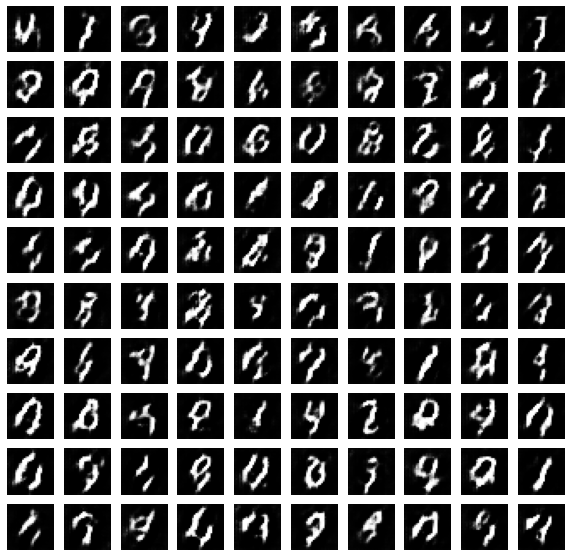

Time for epoch 6 is 17.009517908096313 sec


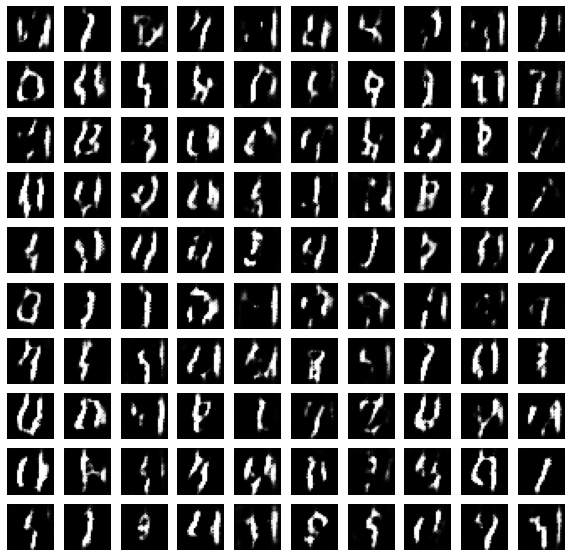

Time for epoch 7 is 17.15490174293518 sec


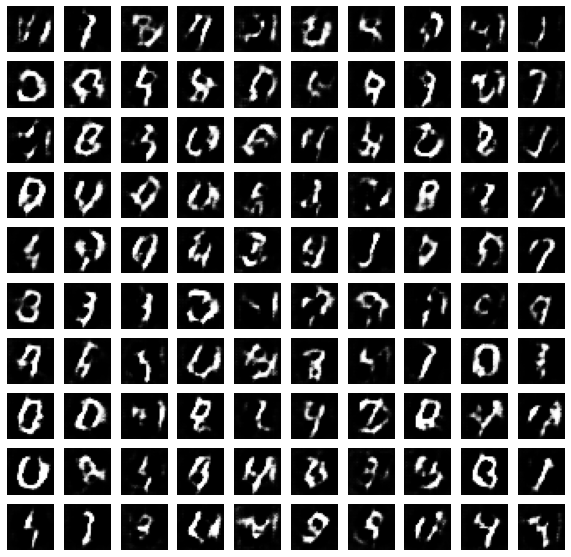

Time for epoch 8 is 17.474796533584595 sec


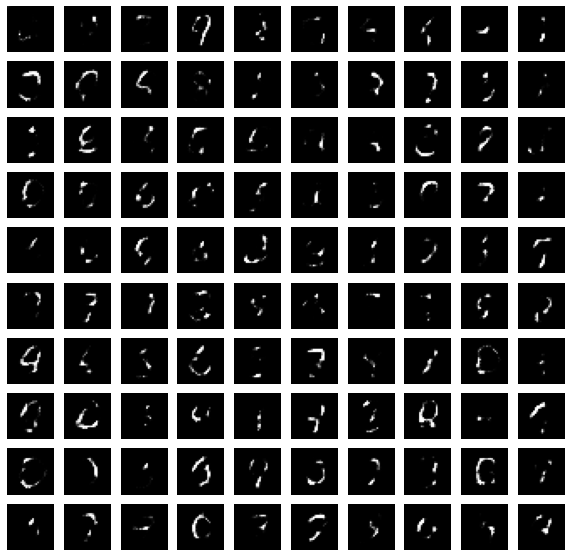

Time for epoch 9 is 17.420387268066406 sec


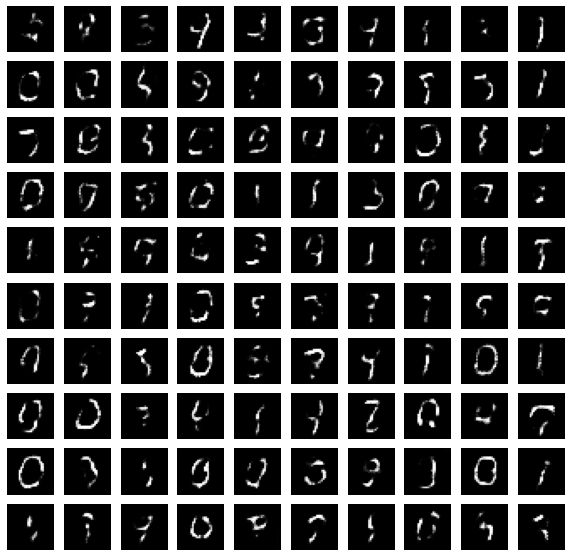

Time for epoch 10 is 17.36578059196472 sec


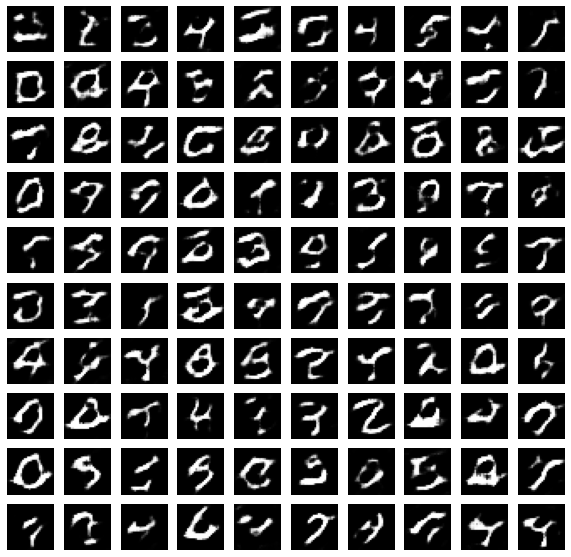

Time for epoch 11 is 17.611677408218384 sec


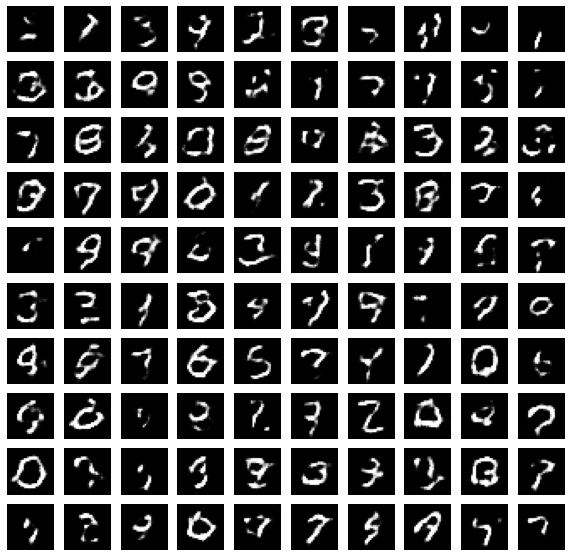

Time for epoch 12 is 17.64752745628357 sec


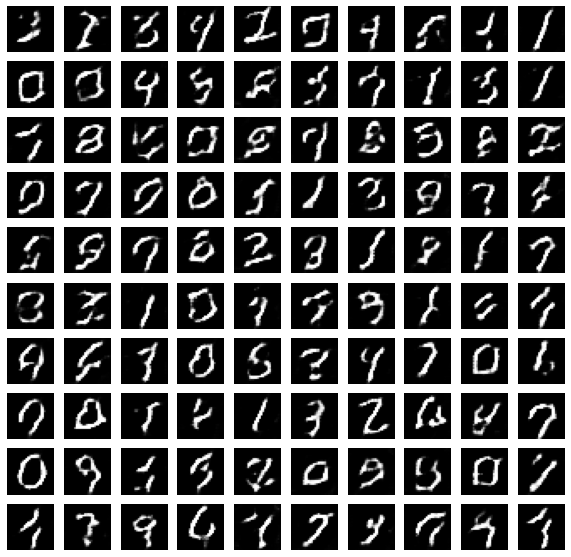

Time for epoch 13 is 17.495287895202637 sec


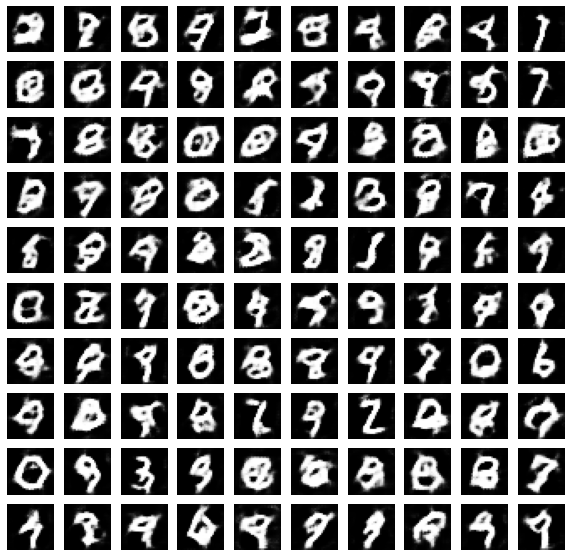

Time for epoch 14 is 17.670337915420532 sec


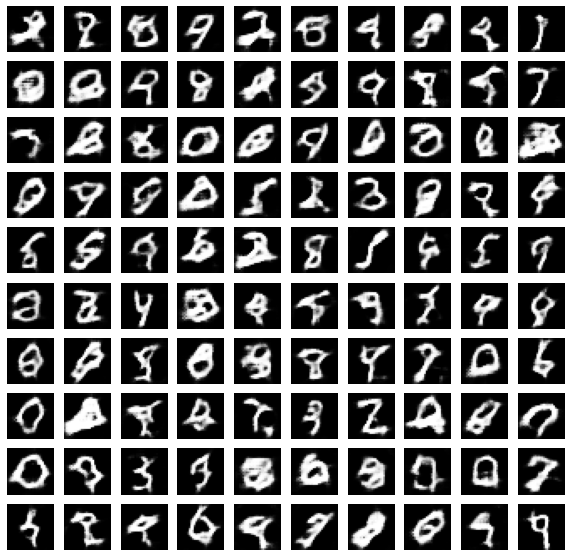

Time for epoch 15 is 17.789071321487427 sec


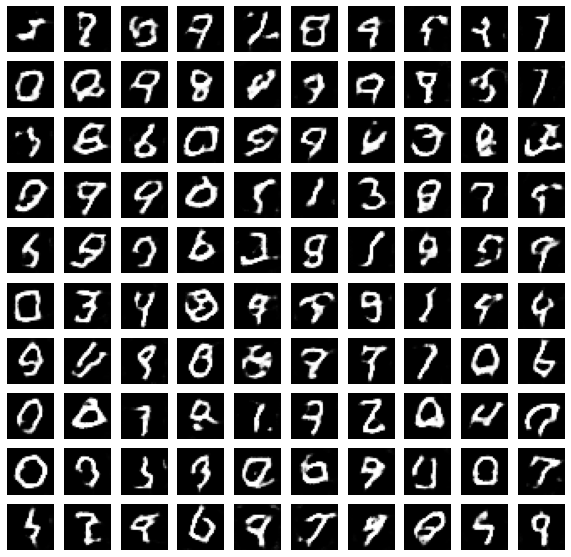

Time for epoch 16 is 17.54975461959839 sec


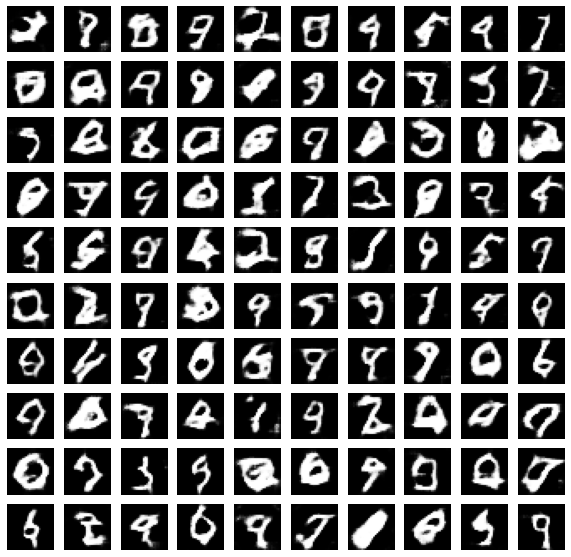

Time for epoch 17 is 17.666658878326416 sec


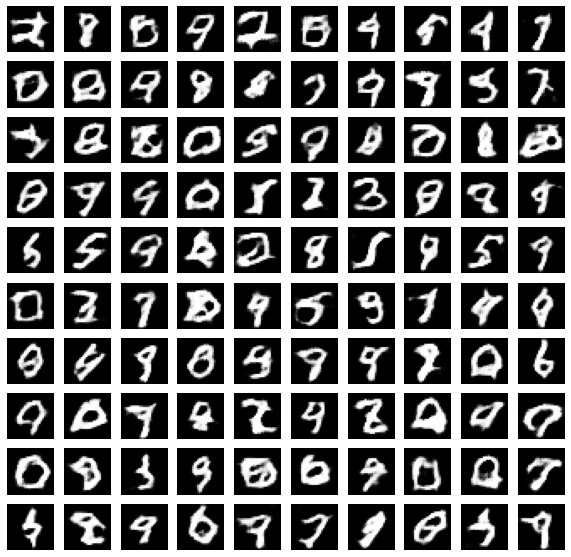

Time for epoch 18 is 17.676349878311157 sec


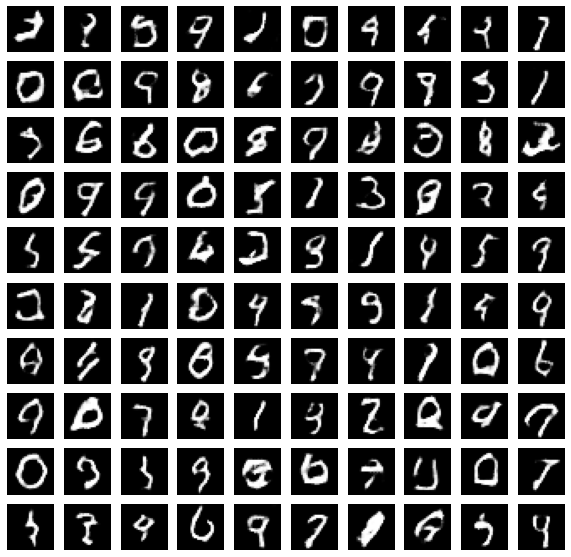

Time for epoch 19 is 17.482601165771484 sec


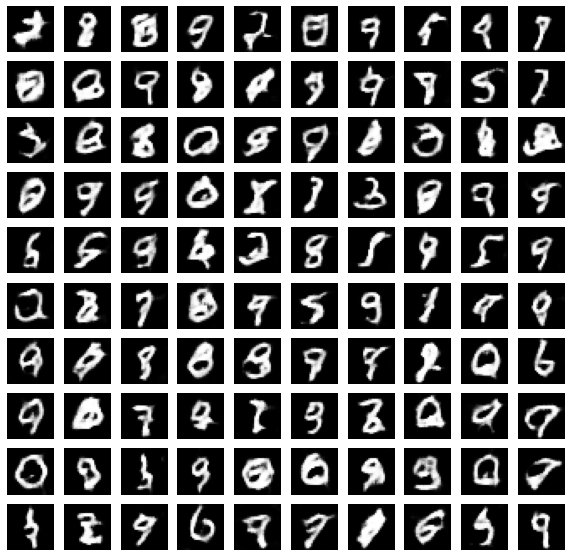

Time for epoch 20 is 17.520915985107422 sec


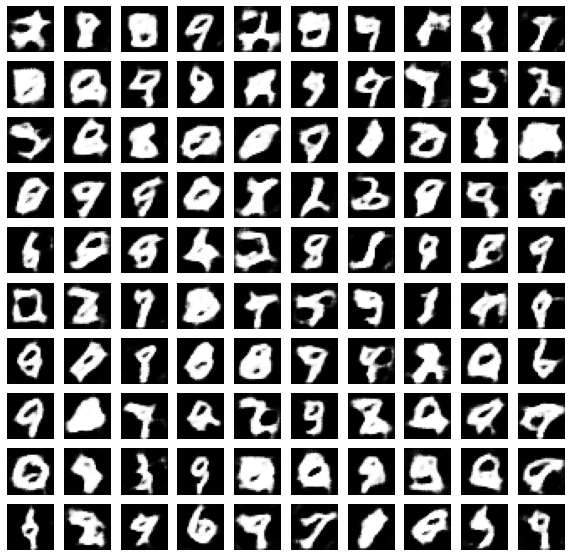

Time for epoch 21 is 17.713212728500366 sec


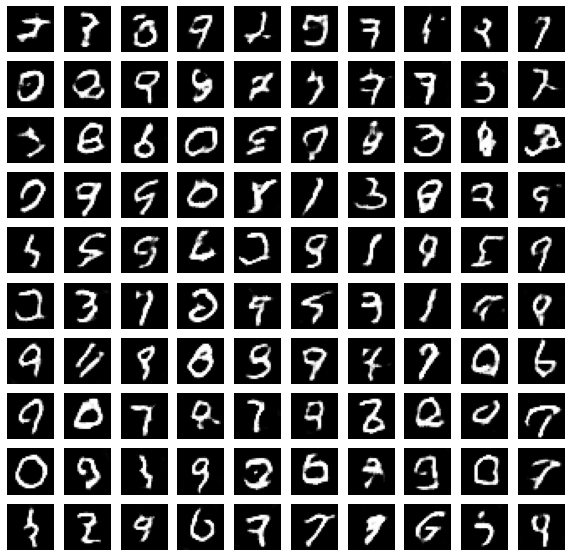

Time for epoch 22 is 17.602665185928345 sec


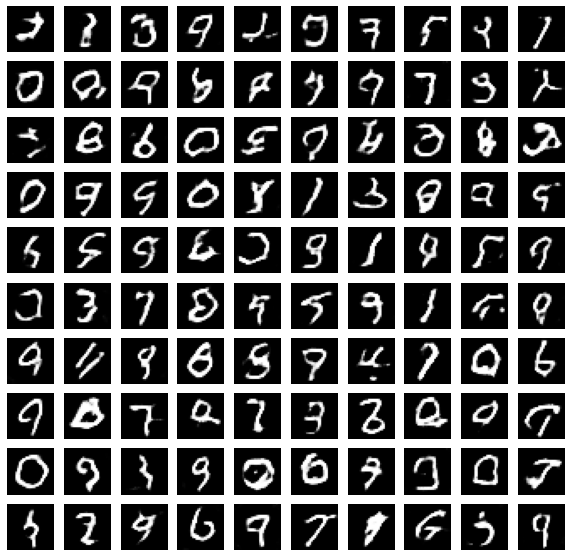

Time for epoch 23 is 17.559423208236694 sec


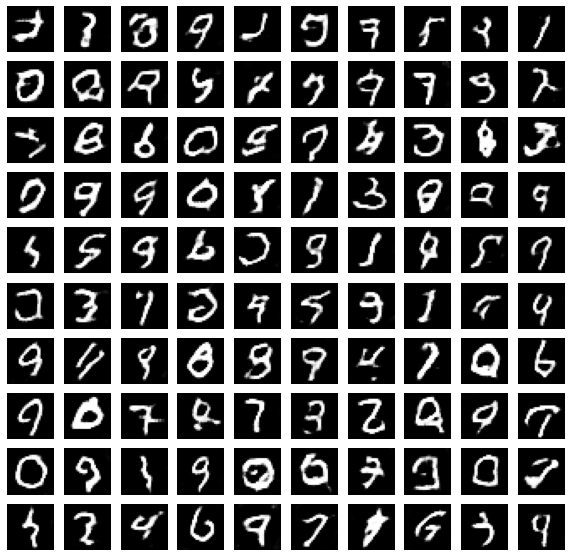

Time for epoch 24 is 17.64634919166565 sec


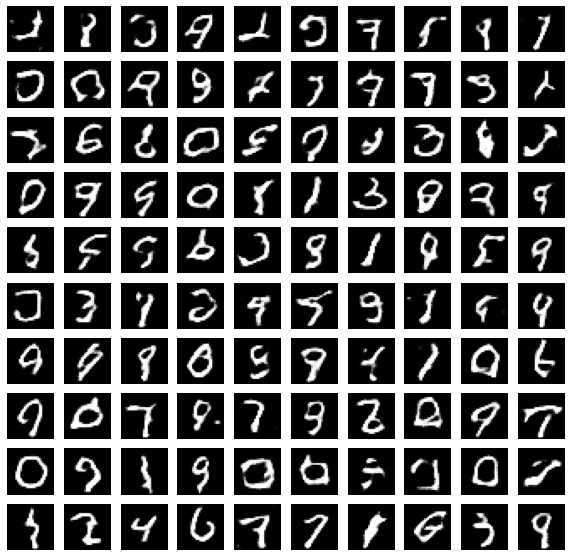

Time for epoch 25 is 17.46627688407898 sec


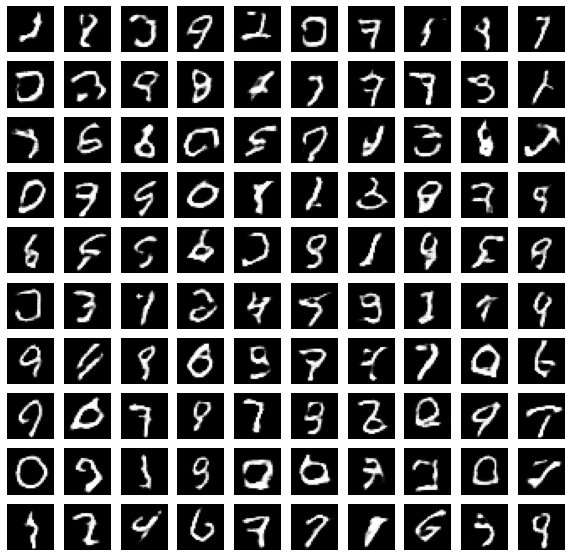

Time for epoch 26 is 17.696575164794922 sec


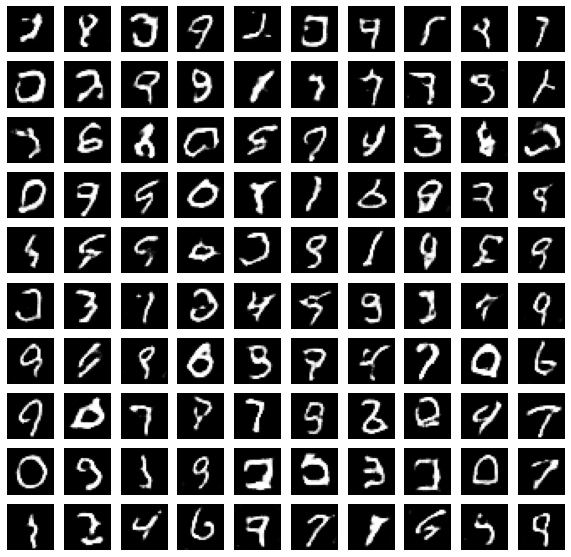

Time for epoch 27 is 17.685548543930054 sec


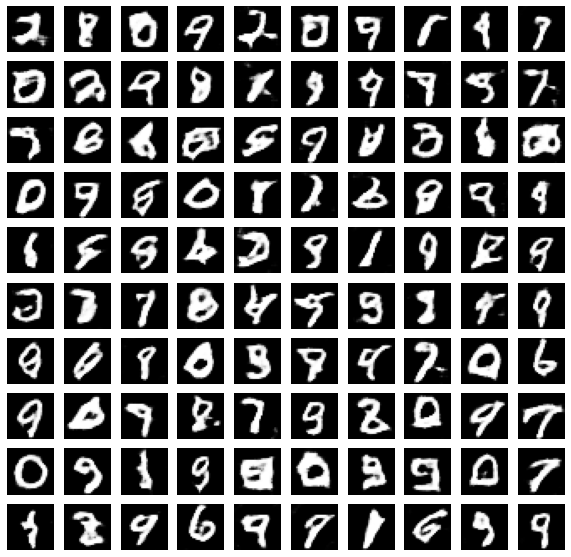

Time for epoch 28 is 17.567780017852783 sec


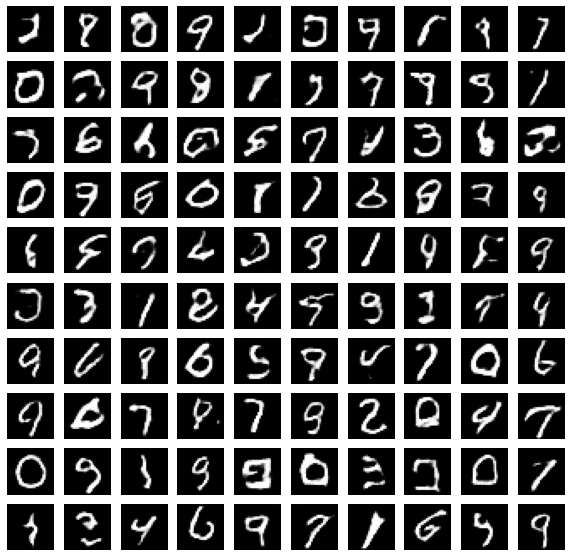

Time for epoch 29 is 17.620919466018677 sec


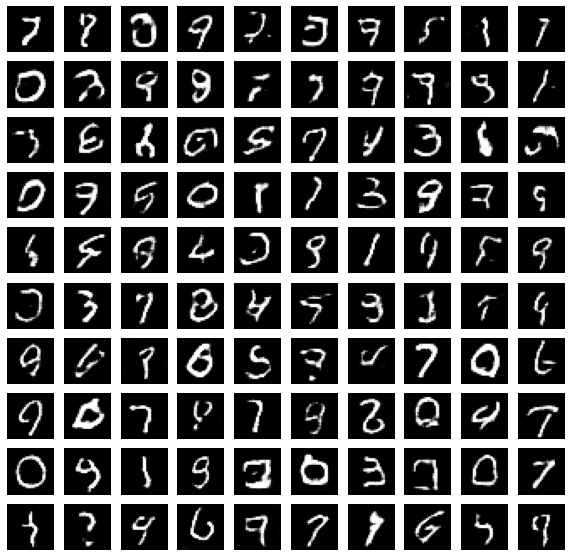

Time for epoch 30 is 17.695159196853638 sec


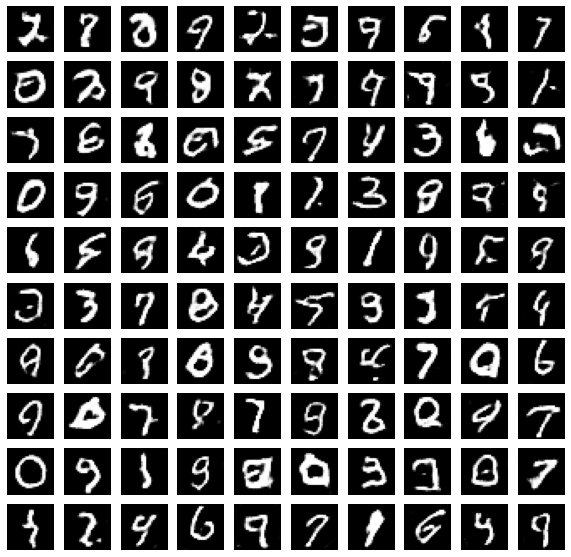

Time for epoch 31 is 17.445485591888428 sec


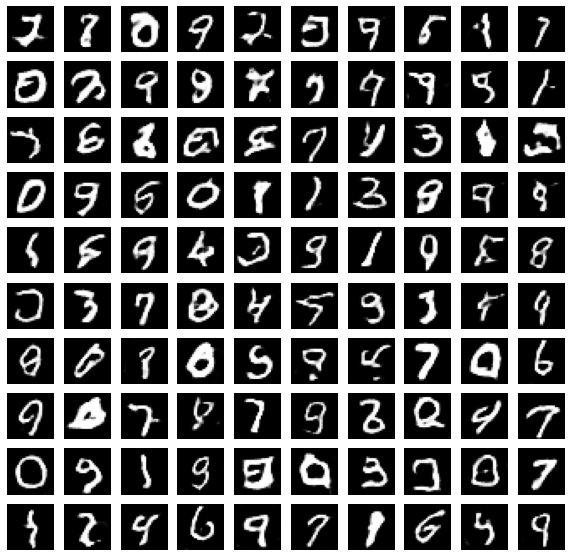

Time for epoch 32 is 17.612069368362427 sec


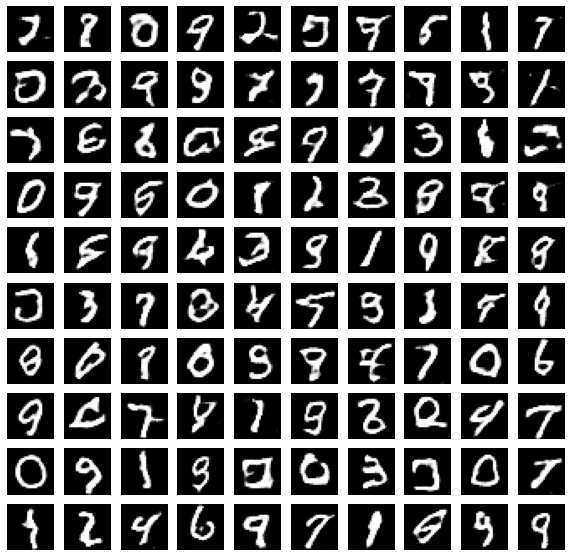

Time for epoch 33 is 17.68829607963562 sec


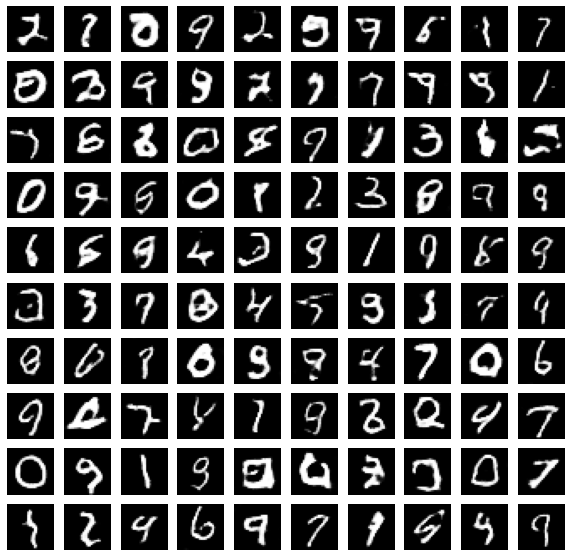

Time for epoch 34 is 17.513002634048462 sec


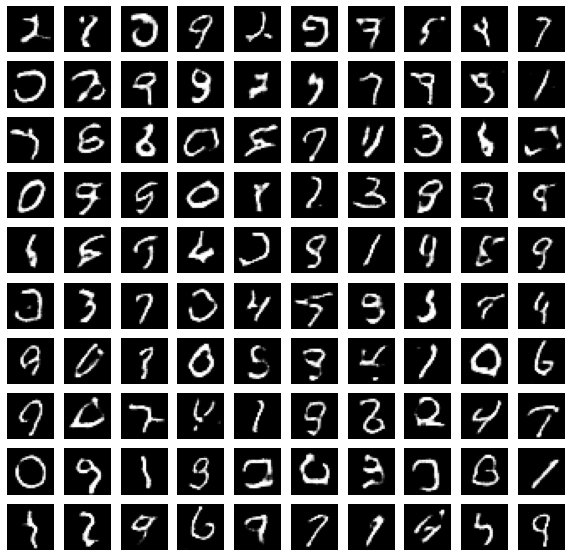

Time for epoch 35 is 17.601263284683228 sec


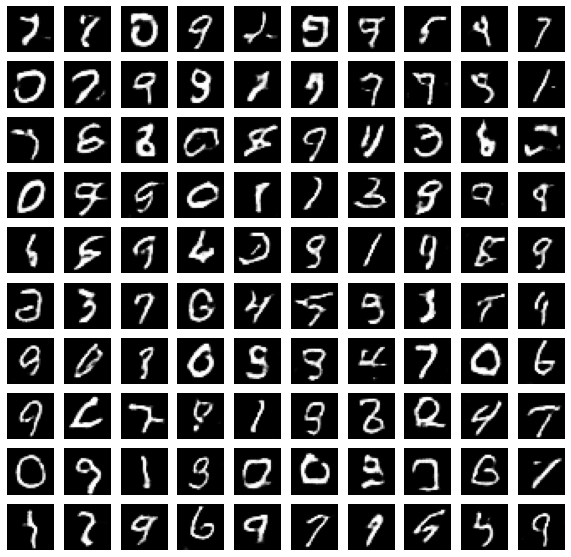

Time for epoch 36 is 17.799440622329712 sec


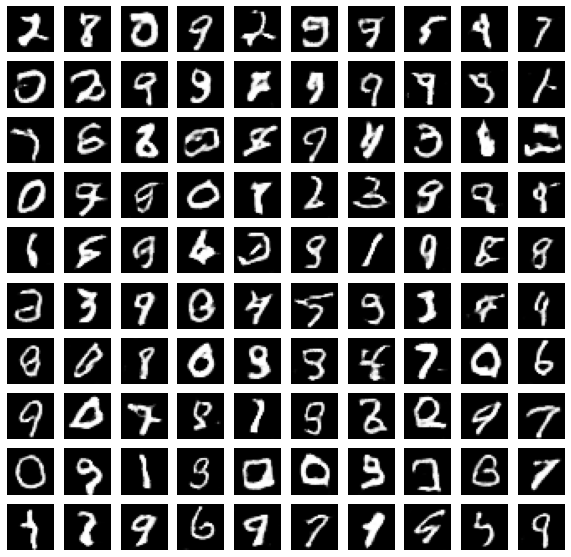

Time for epoch 37 is 17.482067108154297 sec


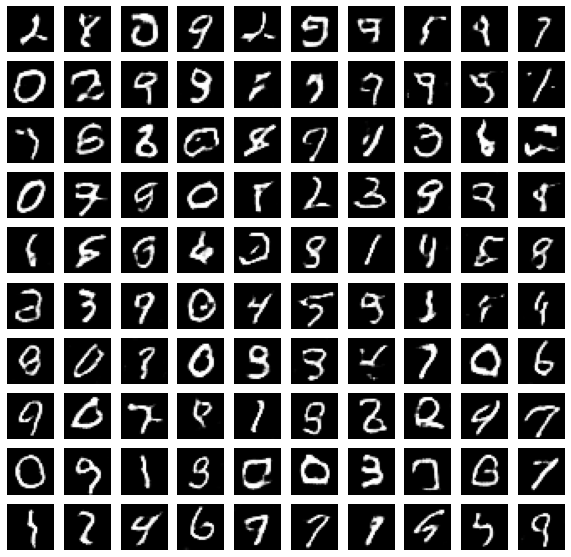

Time for epoch 38 is 17.596415758132935 sec


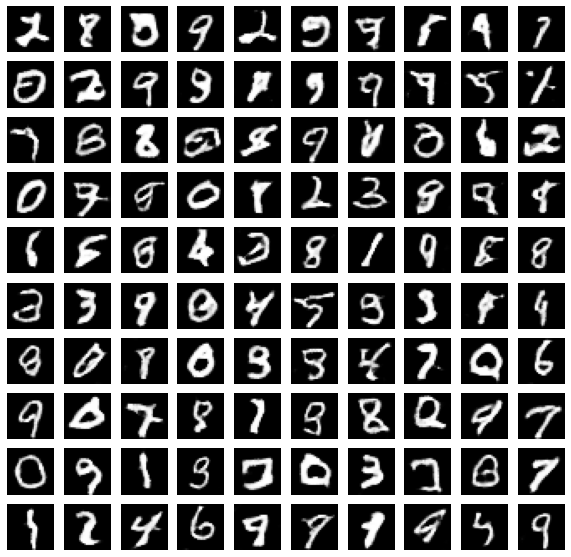

Time for epoch 39 is 17.81913685798645 sec


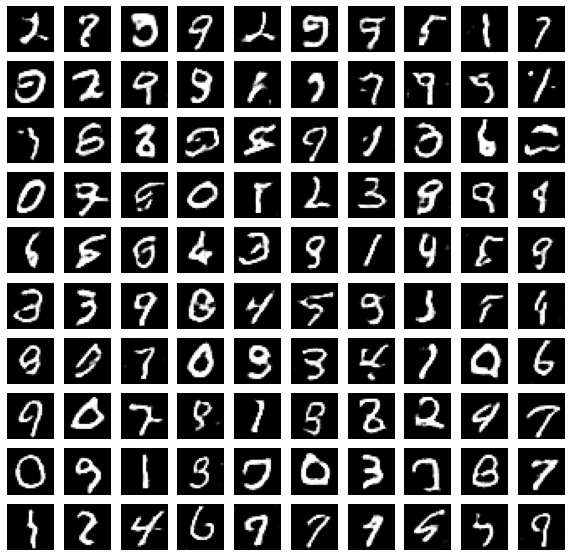

Time for epoch 40 is 17.54680061340332 sec


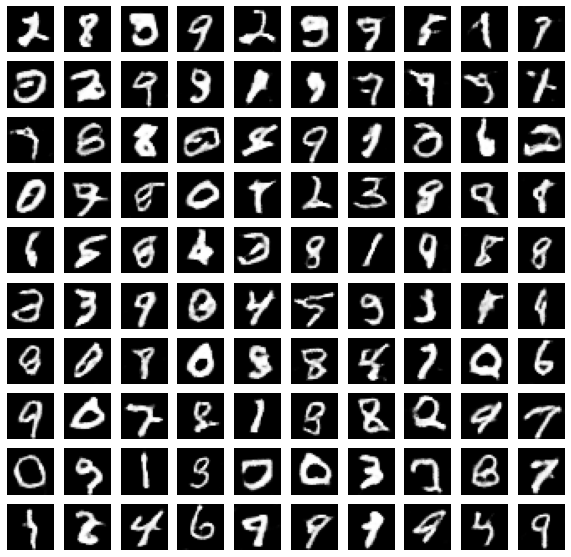

Time for epoch 41 is 17.599627017974854 sec


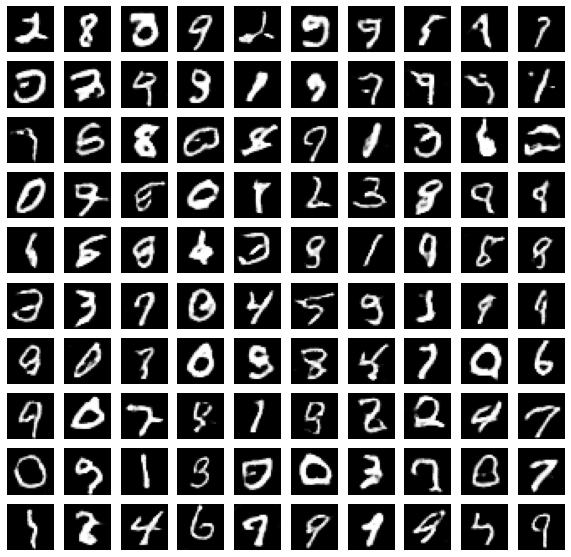

Time for epoch 42 is 17.71067762374878 sec


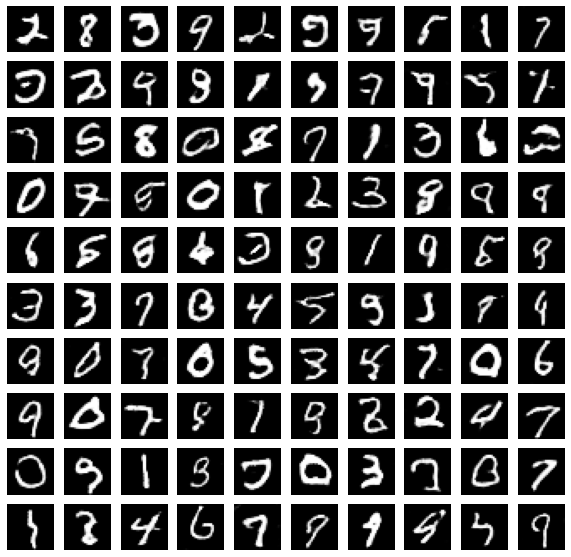

Time for epoch 43 is 17.504082679748535 sec


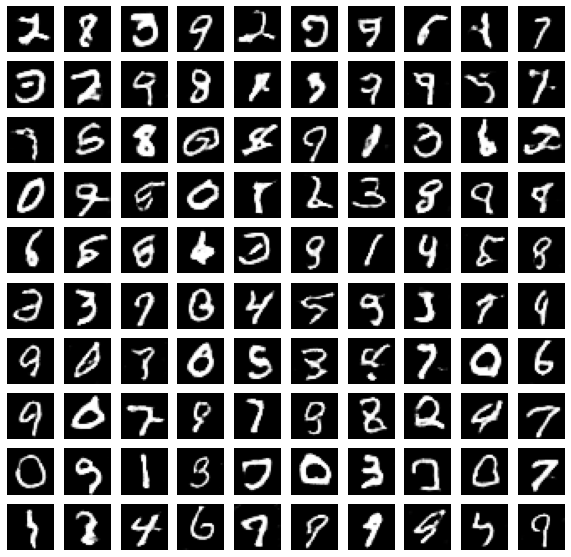

Time for epoch 44 is 17.619025468826294 sec


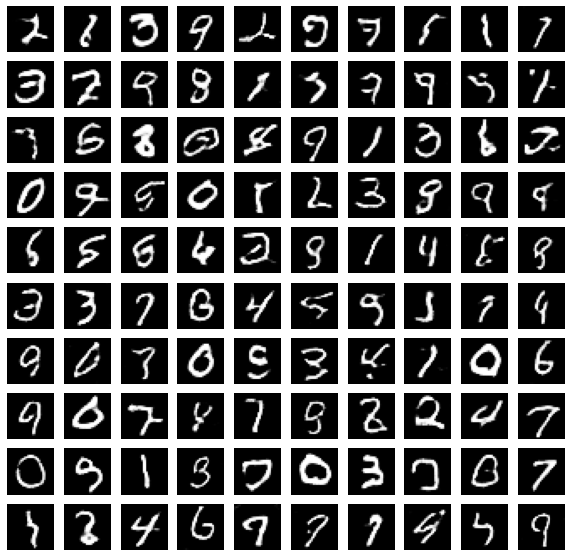

Time for epoch 45 is 17.659465074539185 sec


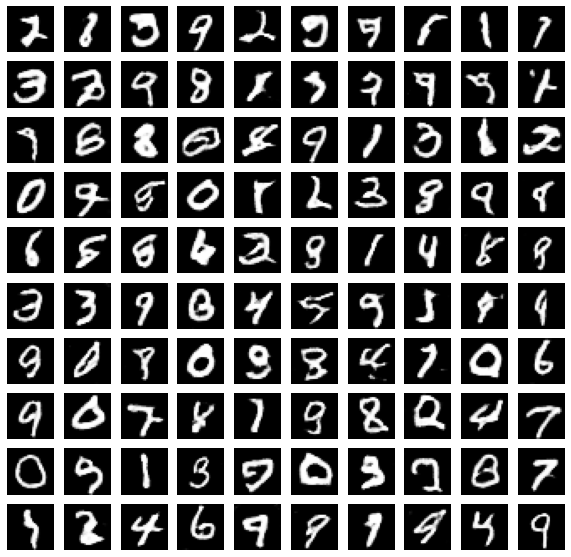

Time for epoch 46 is 17.540799140930176 sec


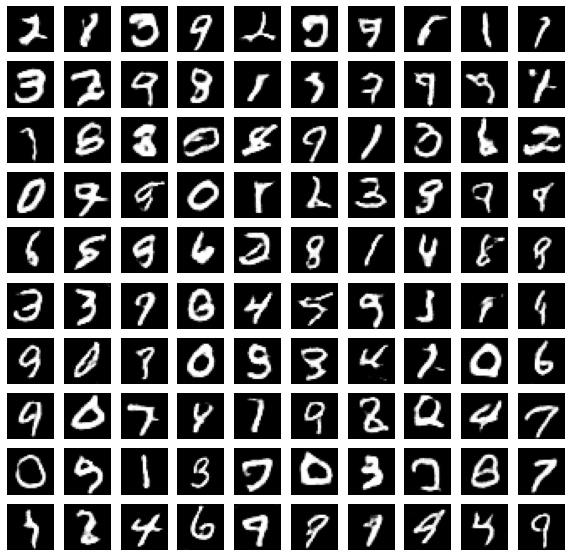

Time for epoch 47 is 17.582643747329712 sec


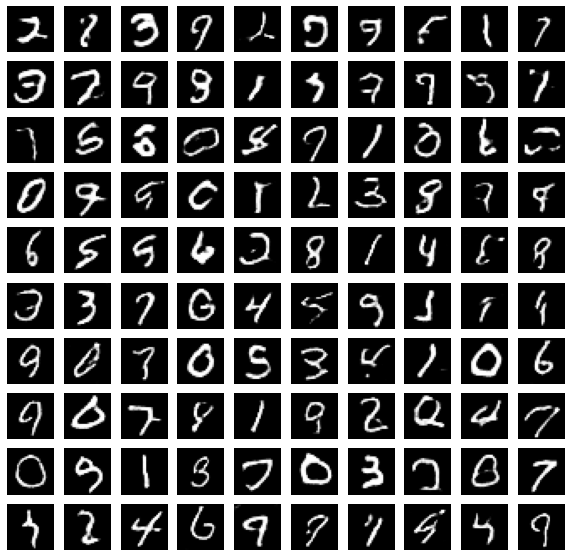

Time for epoch 48 is 17.6143581867218 sec


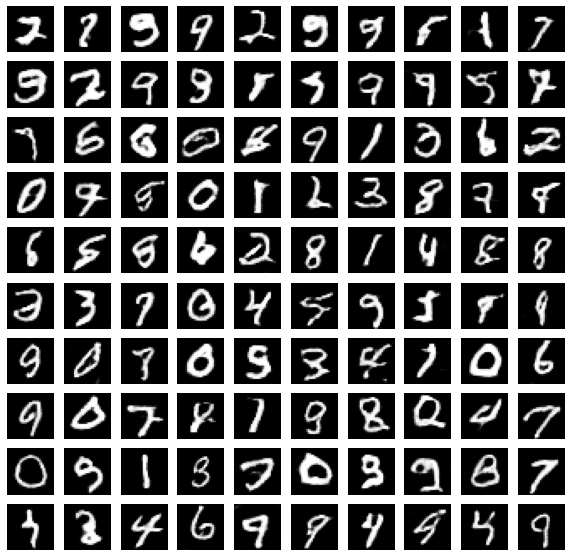

Time for epoch 49 is 17.502615928649902 sec


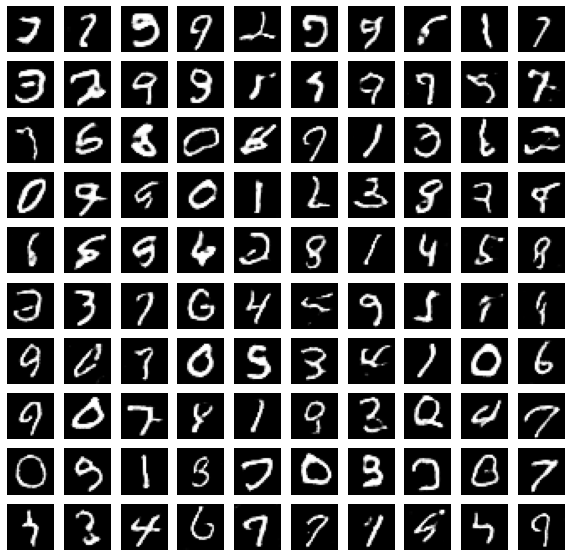

Time for epoch 50 is 17.703621864318848 sec


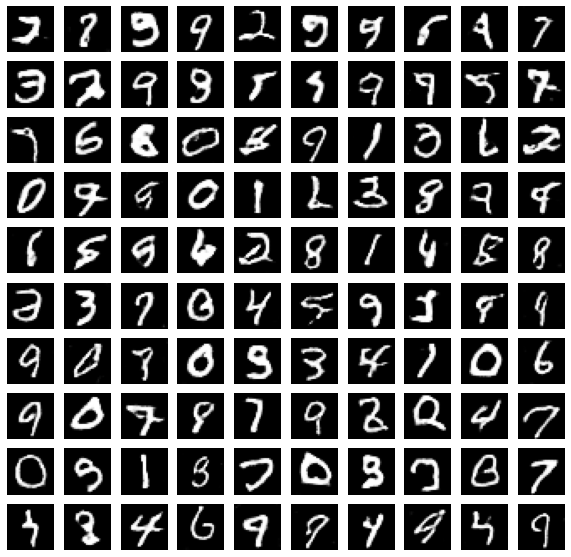

Time for epoch 51 is 17.565507411956787 sec


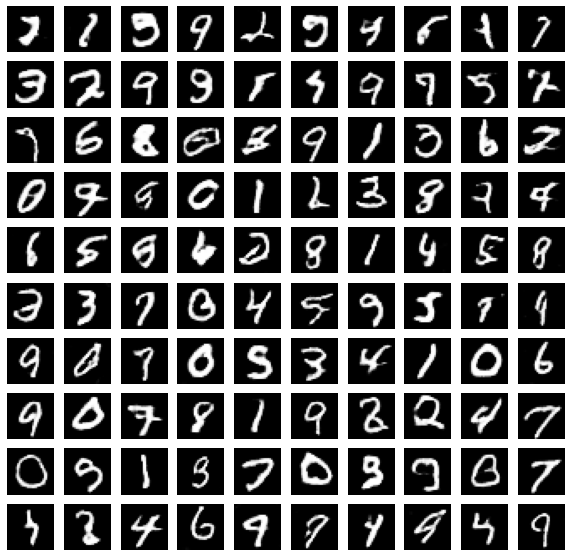

Time for epoch 52 is 17.590436935424805 sec


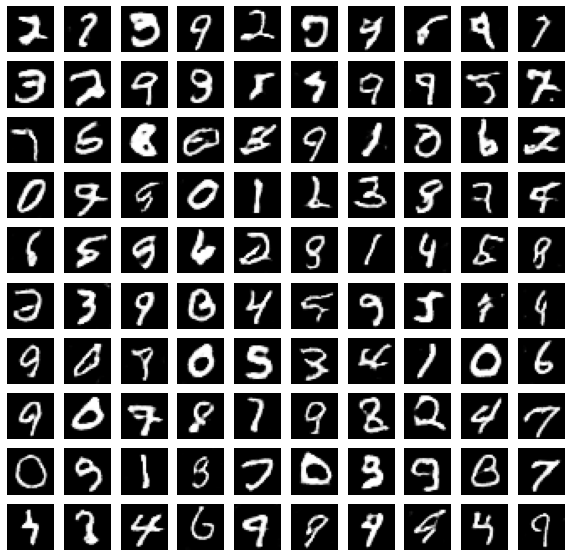

Time for epoch 53 is 17.62899923324585 sec


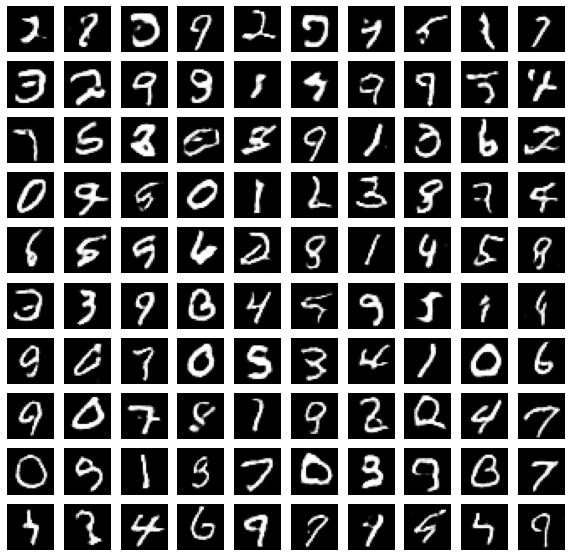

Time for epoch 54 is 17.581850051879883 sec


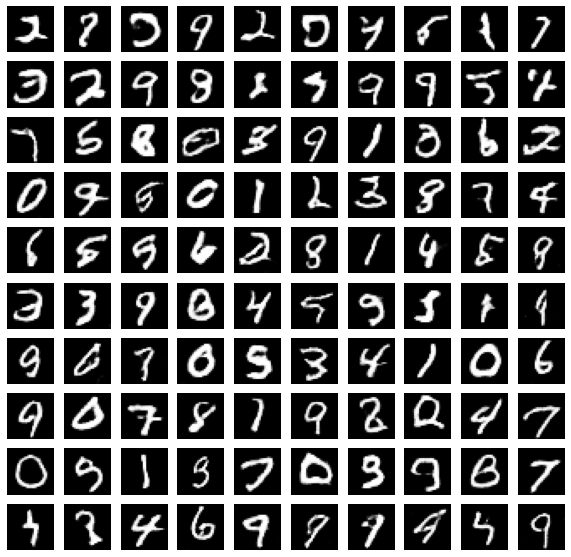

Time for epoch 55 is 17.555394172668457 sec


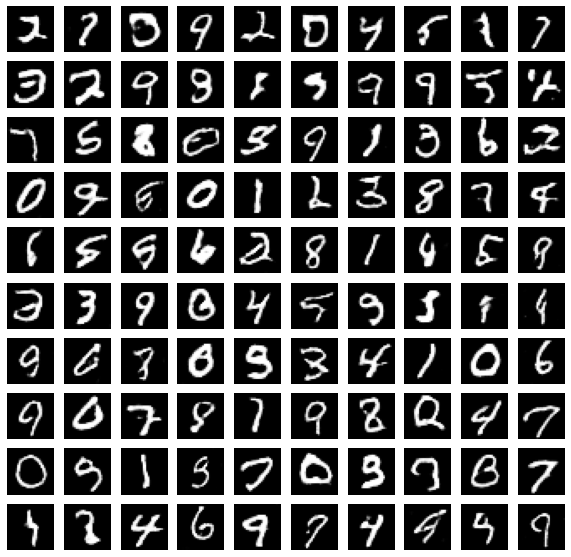

Time for epoch 56 is 17.546009302139282 sec


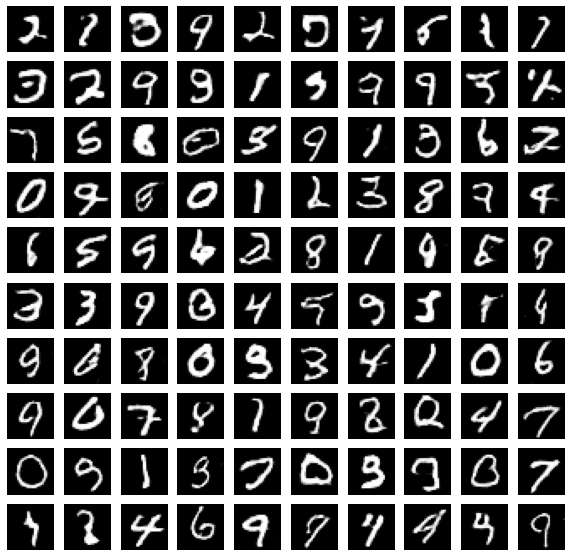

Time for epoch 57 is 17.630693912506104 sec


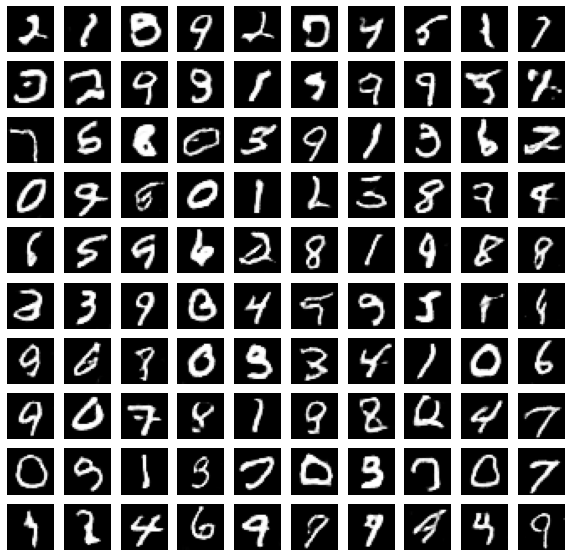

Time for epoch 58 is 17.599149703979492 sec


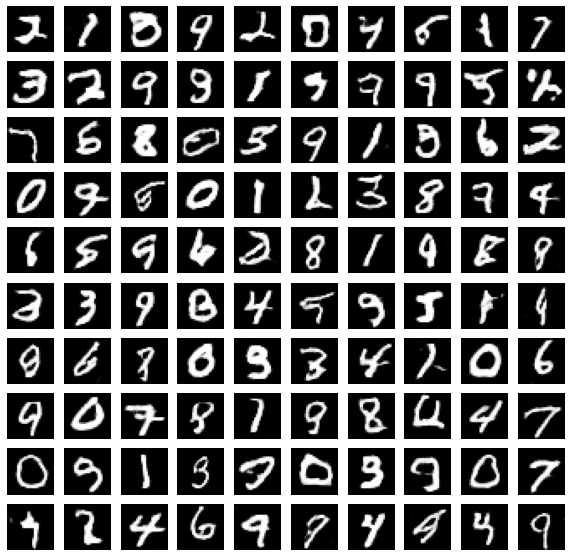

Time for epoch 59 is 17.629329204559326 sec


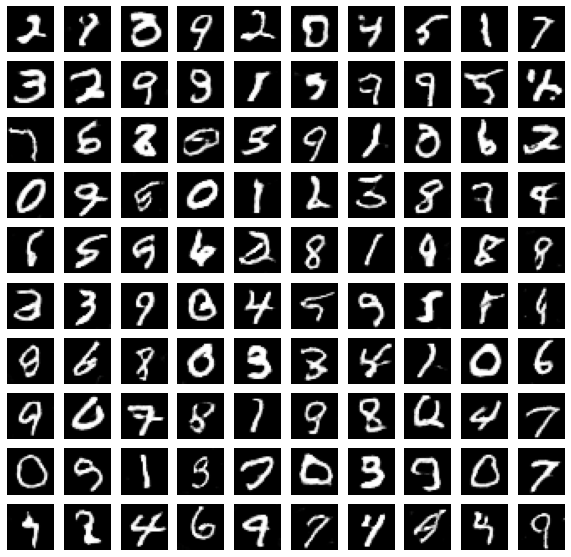

Time for epoch 60 is 17.69560933113098 sec


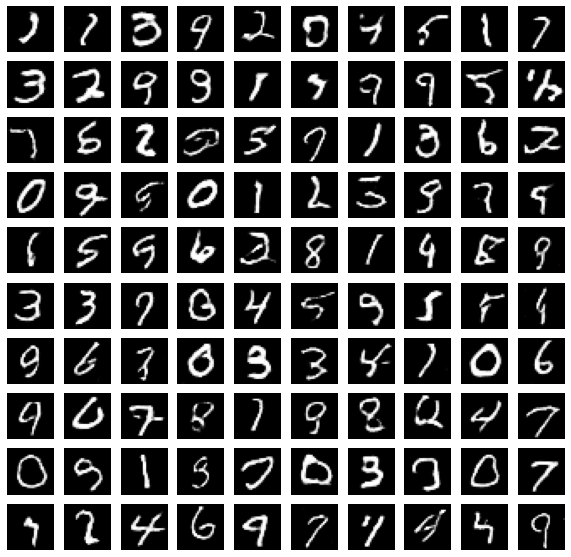

Time for epoch 61 is 17.487843990325928 sec


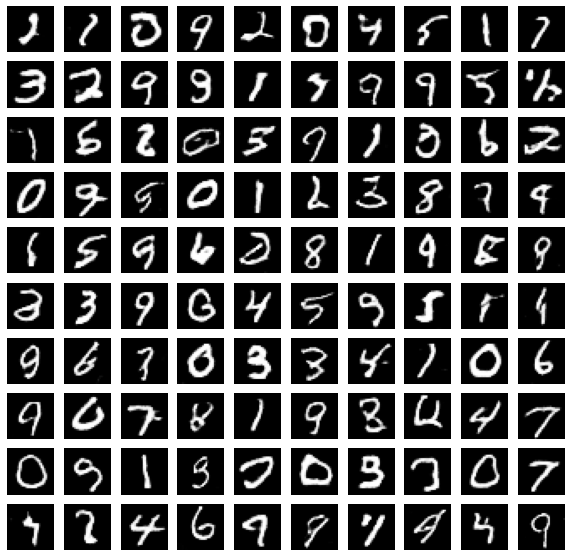

Time for epoch 62 is 17.619605779647827 sec


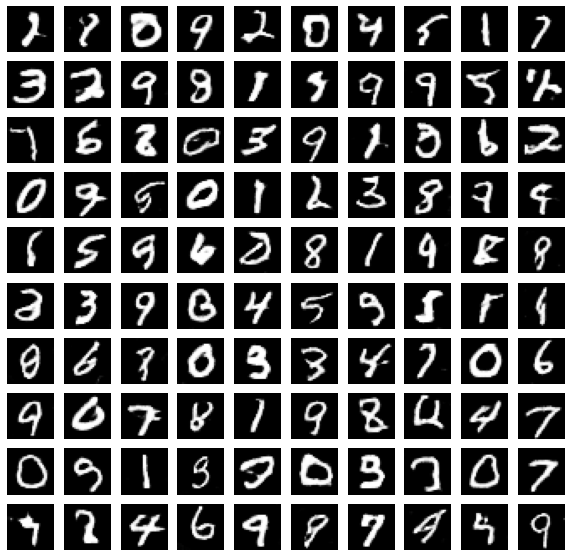

Time for epoch 63 is 17.60563087463379 sec


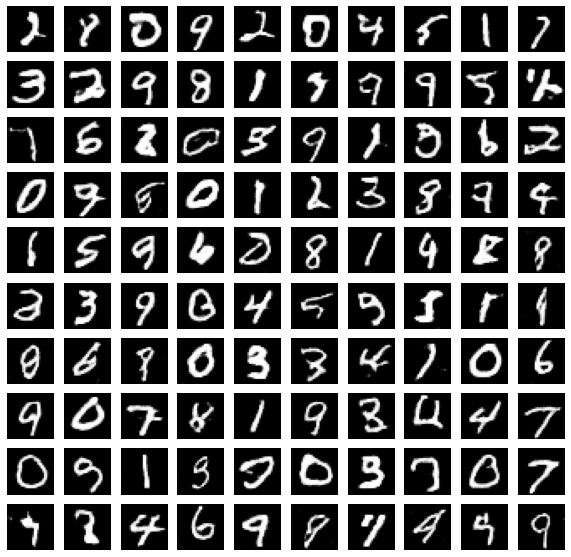

Time for epoch 64 is 17.620367765426636 sec


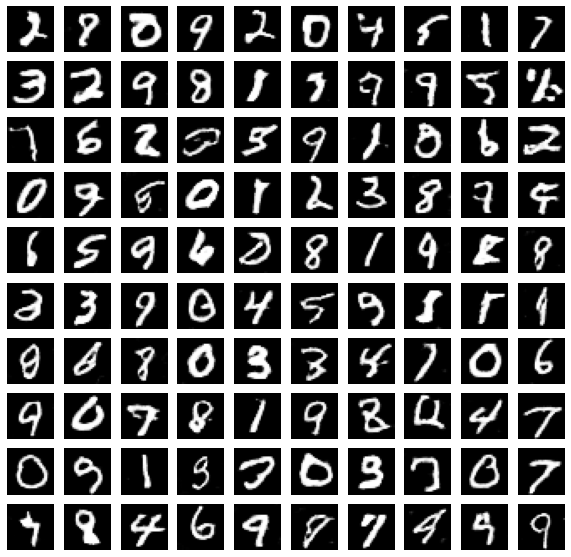

Time for epoch 65 is 17.622246980667114 sec


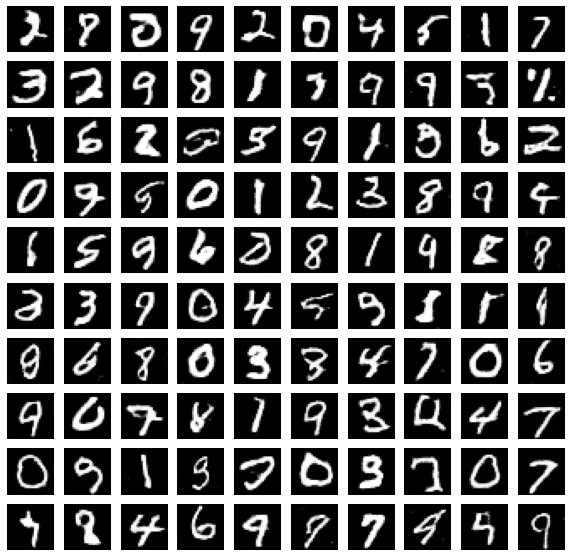

Time for epoch 66 is 17.666598558425903 sec


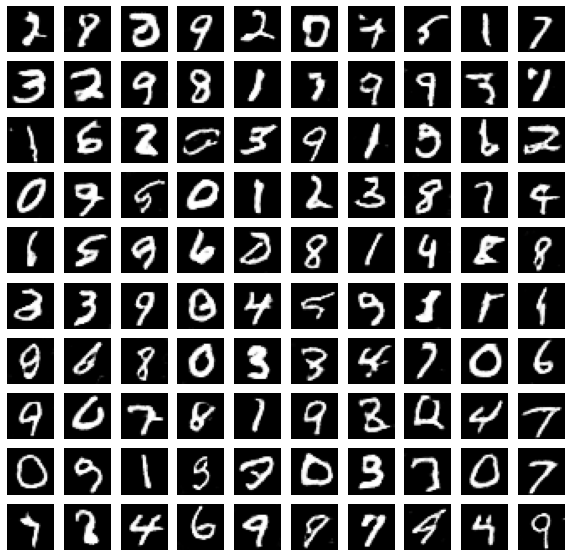

Time for epoch 67 is 17.48229217529297 sec


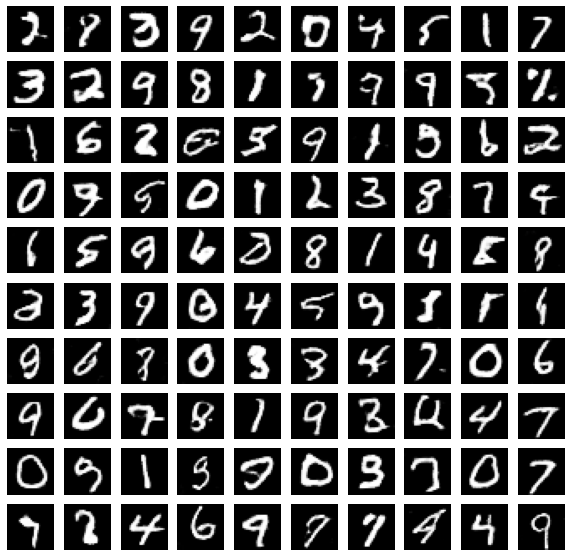

Time for epoch 68 is 17.58223295211792 sec


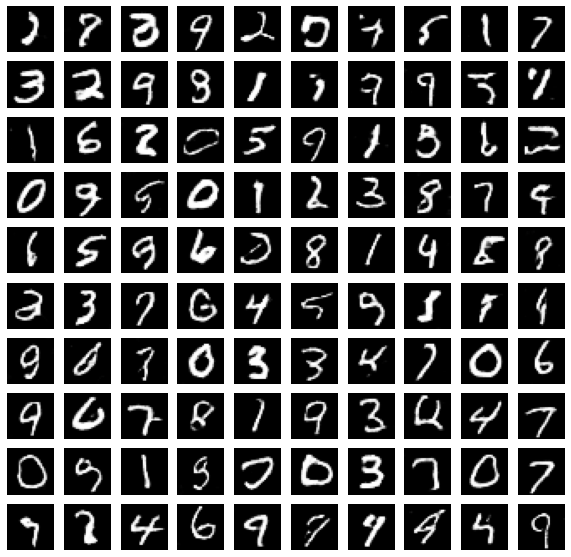

Time for epoch 69 is 17.582695245742798 sec


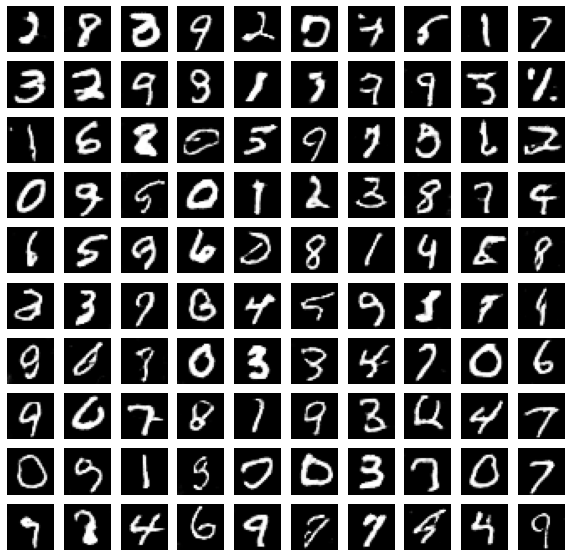

Time for epoch 70 is 17.53944730758667 sec


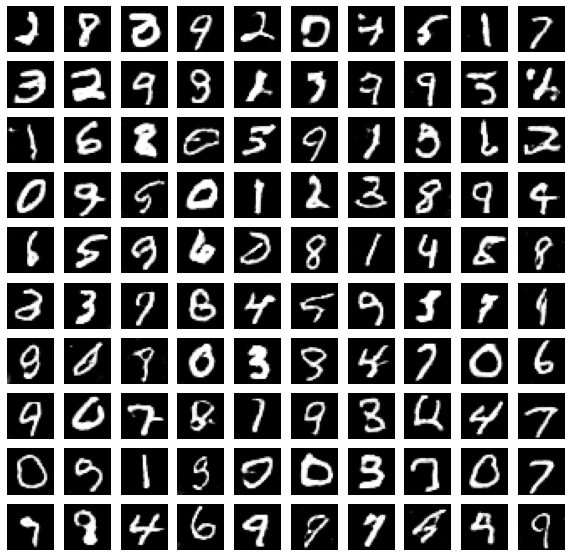

Time for epoch 71 is 17.703899145126343 sec


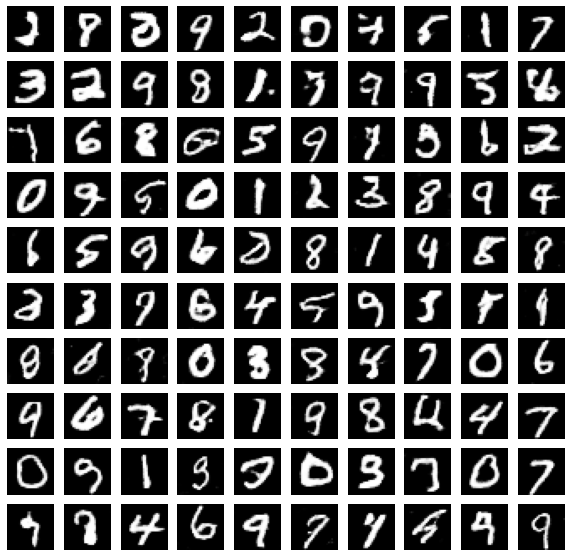

Time for epoch 72 is 17.74155020713806 sec


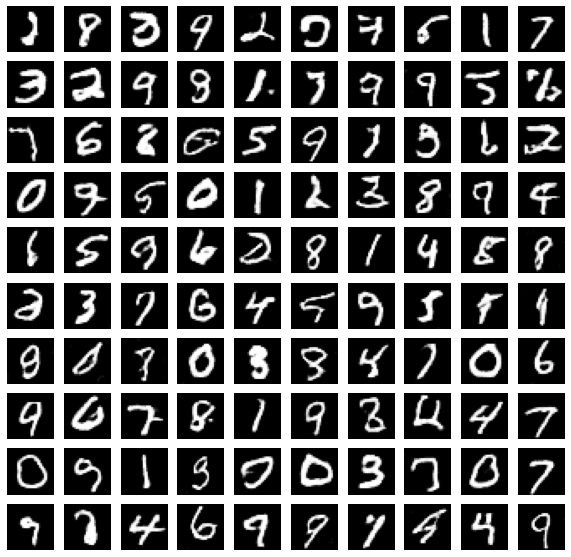

Time for epoch 73 is 17.57754349708557 sec


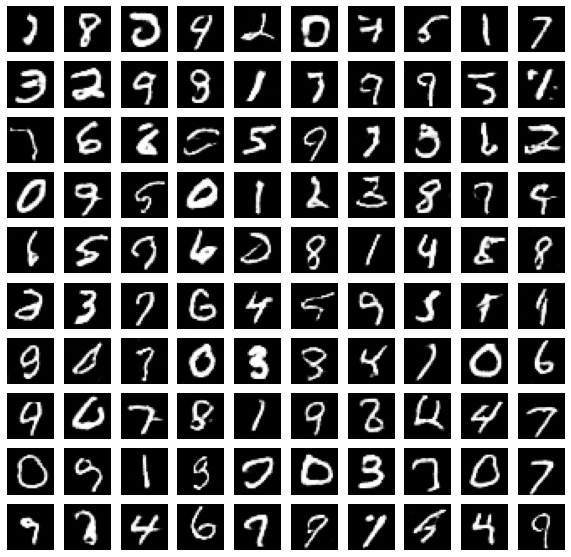

Time for epoch 74 is 17.75003933906555 sec


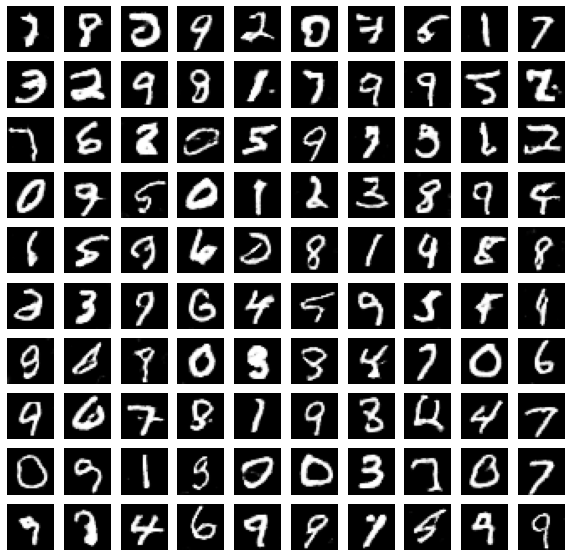

Time for epoch 75 is 17.65080952644348 sec


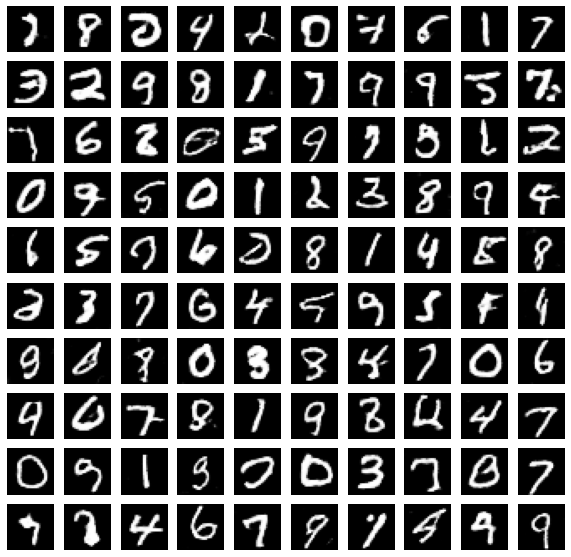

Time for epoch 76 is 17.53830862045288 sec


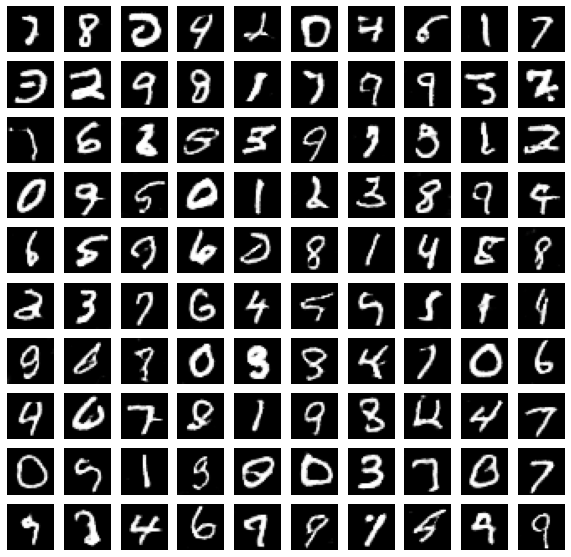

Time for epoch 77 is 17.62847113609314 sec


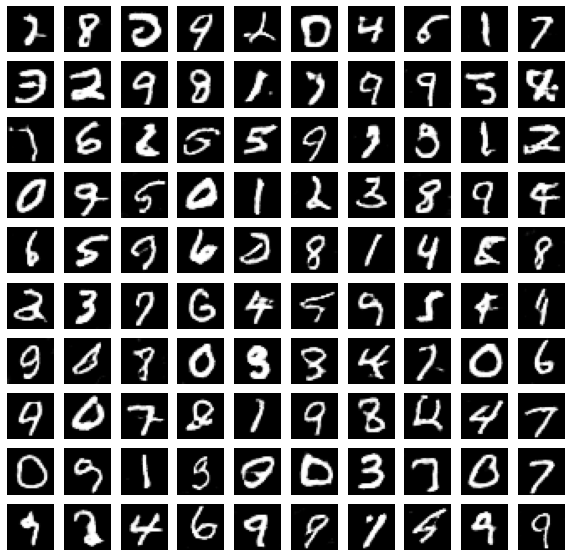

Time for epoch 78 is 17.692954778671265 sec


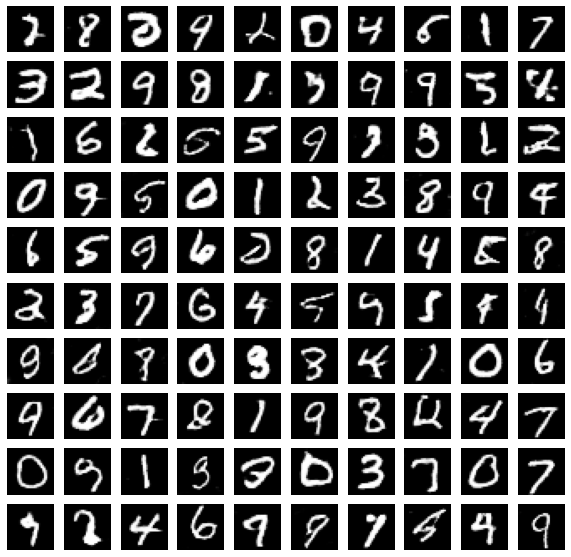

Time for epoch 79 is 17.47536301612854 sec


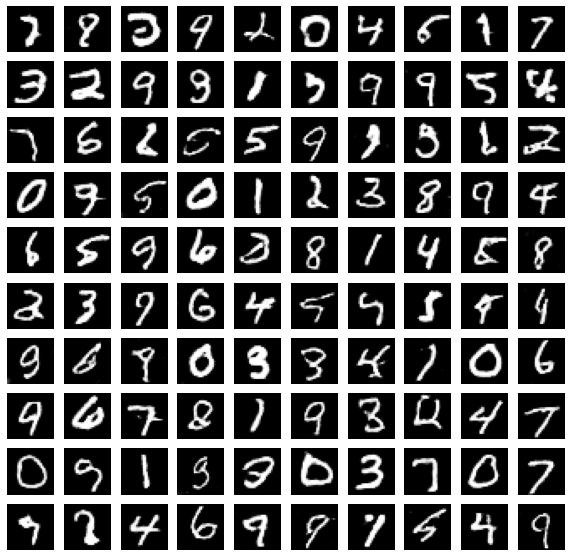

Time for epoch 80 is 17.607712984085083 sec


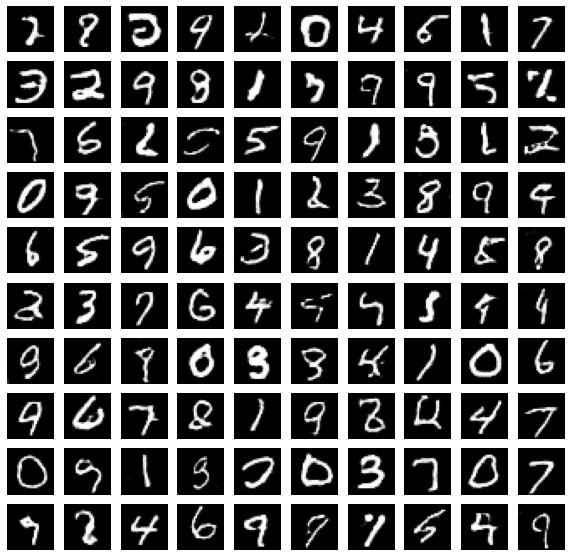

Time for epoch 81 is 17.715363264083862 sec


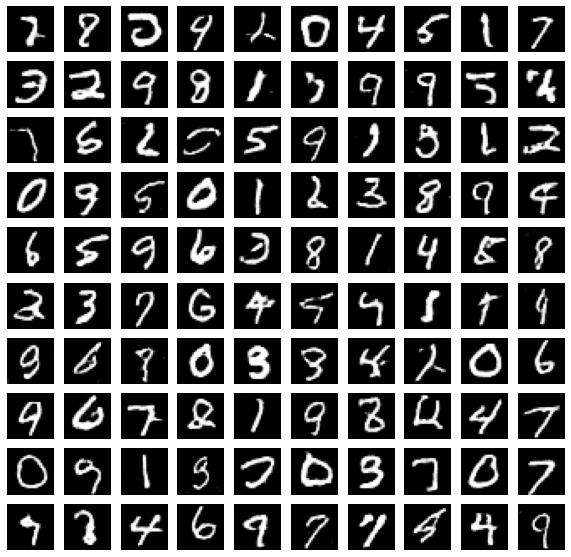

Time for epoch 82 is 17.57734990119934 sec


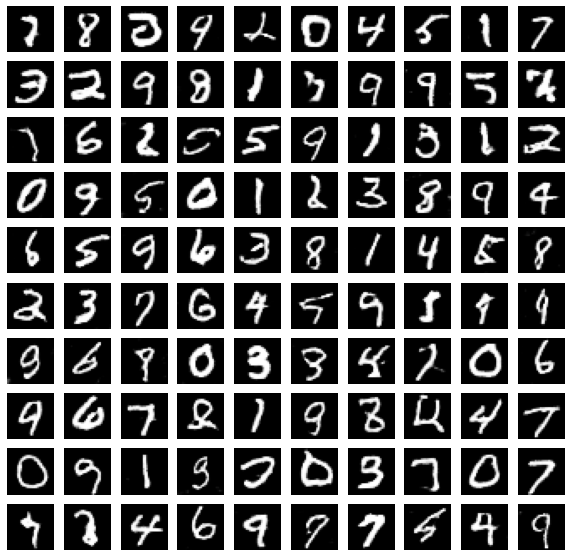

Time for epoch 83 is 17.633054971694946 sec


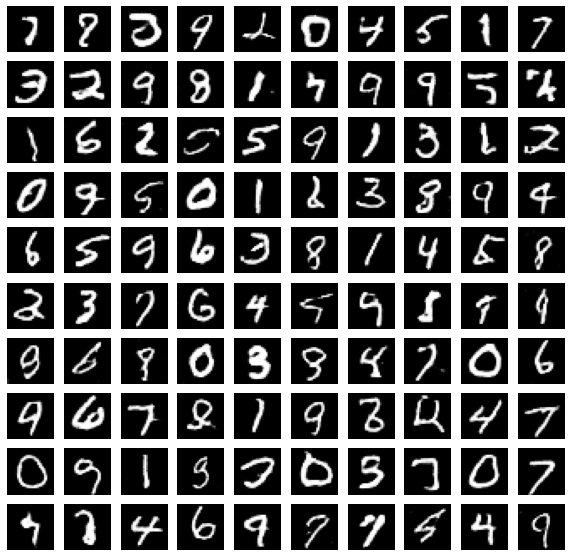

Time for epoch 84 is 17.777674198150635 sec


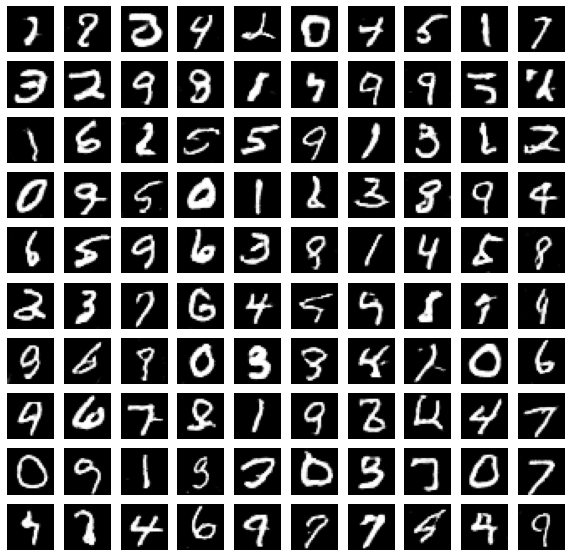

Time for epoch 85 is 17.55073118209839 sec


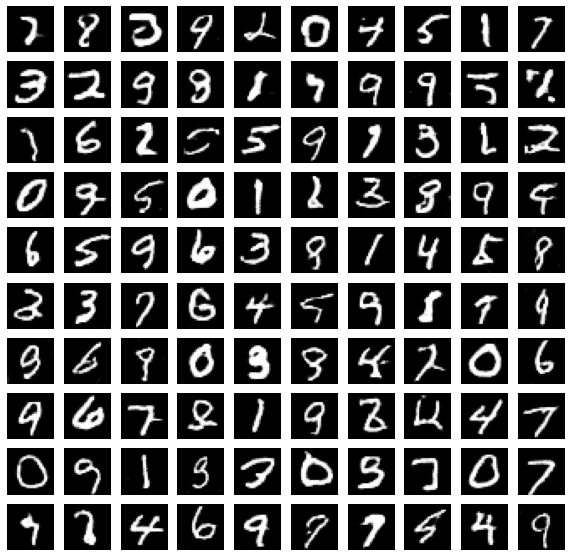

Time for epoch 86 is 17.6688392162323 sec


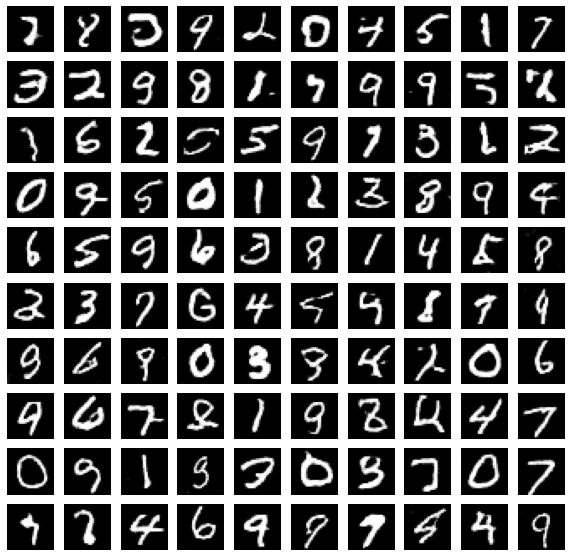

Time for epoch 87 is 17.65715265274048 sec


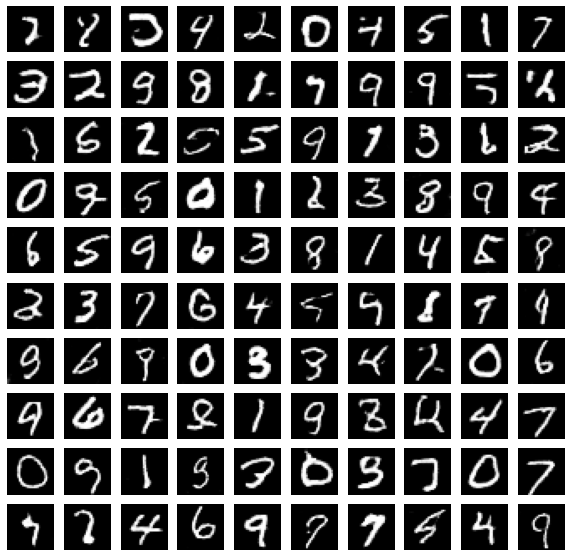

Time for epoch 88 is 17.546932697296143 sec


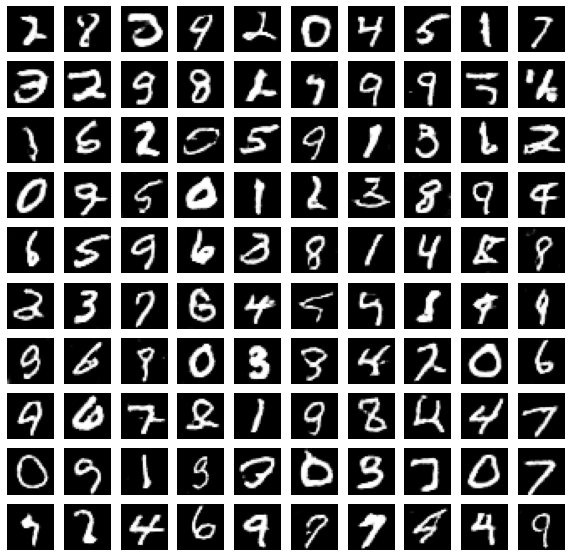

Time for epoch 89 is 17.595917463302612 sec


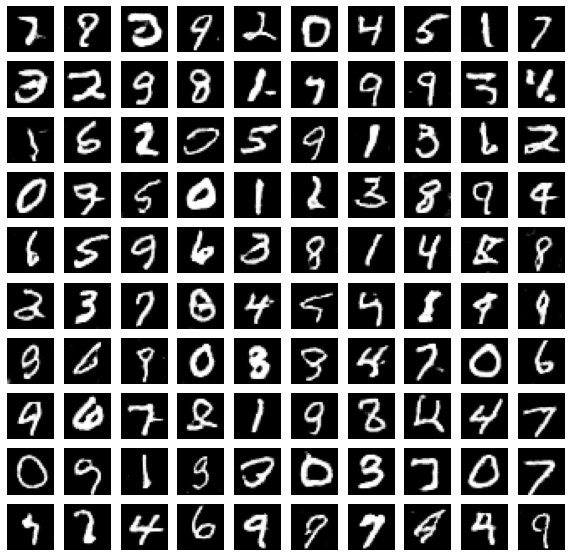

Time for epoch 90 is 17.62131690979004 sec


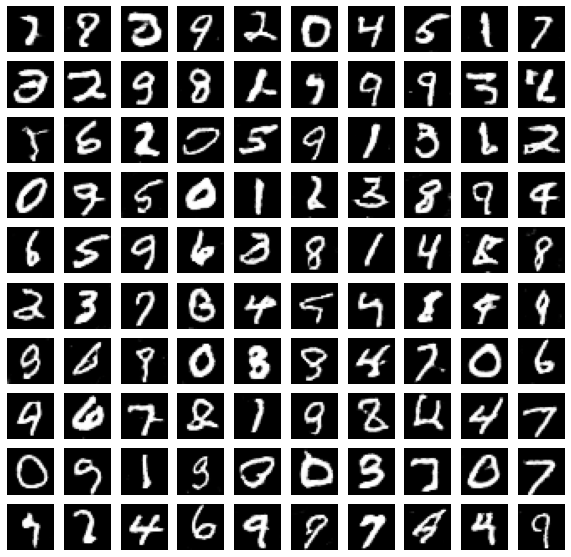

Time for epoch 91 is 17.65317463874817 sec


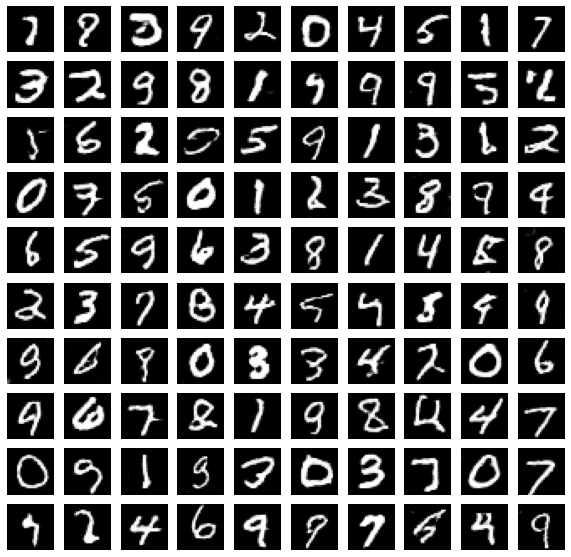

Time for epoch 92 is 17.6266188621521 sec


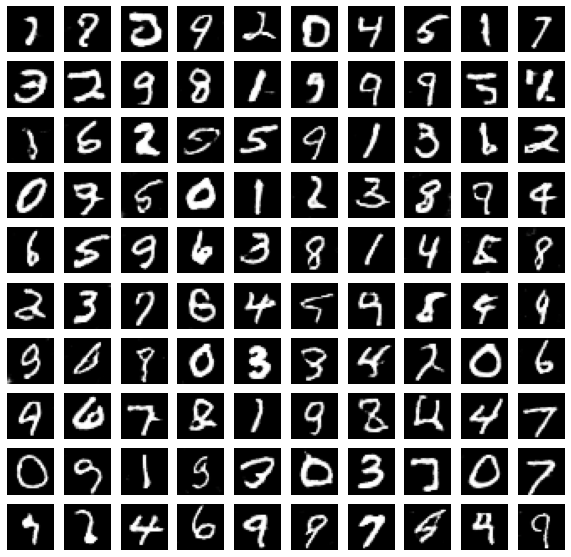

Time for epoch 93 is 17.707242965698242 sec


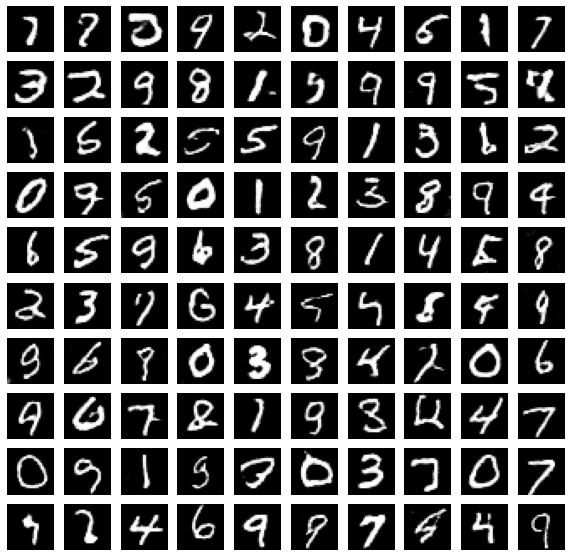

Time for epoch 94 is 17.4833083152771 sec


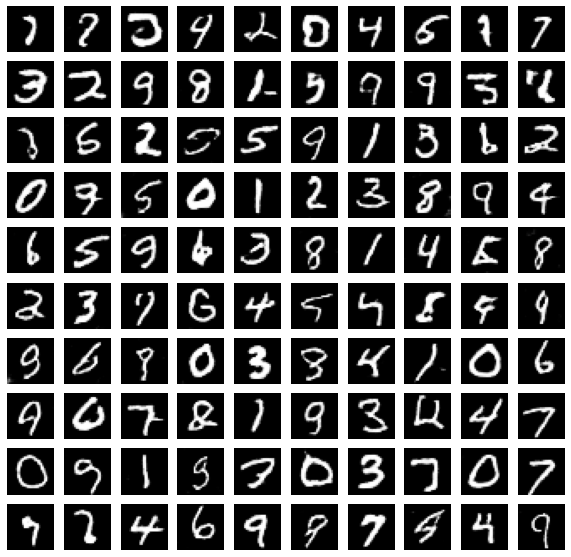

Time for epoch 95 is 17.648690700531006 sec


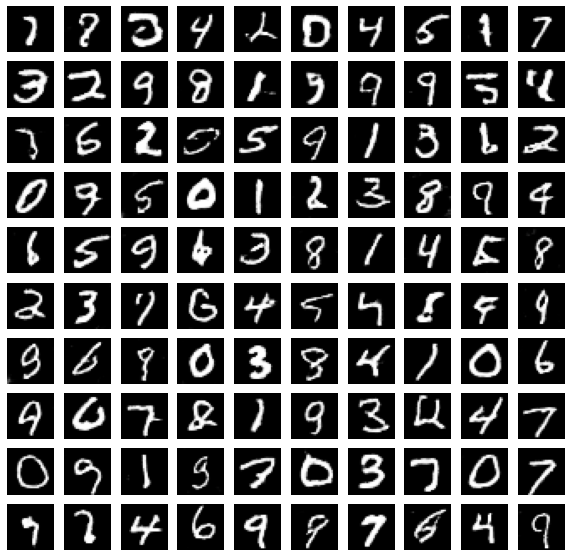

Time for epoch 96 is 17.62509059906006 sec


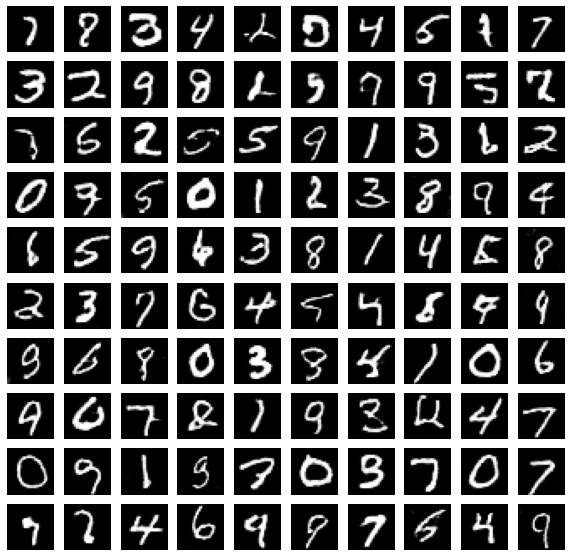

Time for epoch 97 is 17.512038469314575 sec


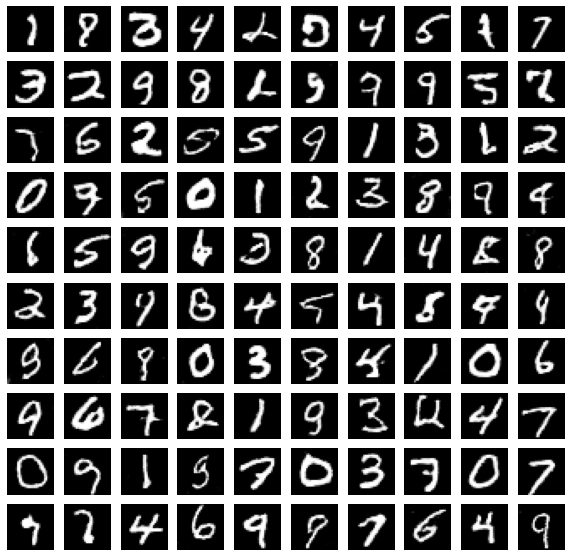

Time for epoch 98 is 17.707438468933105 sec


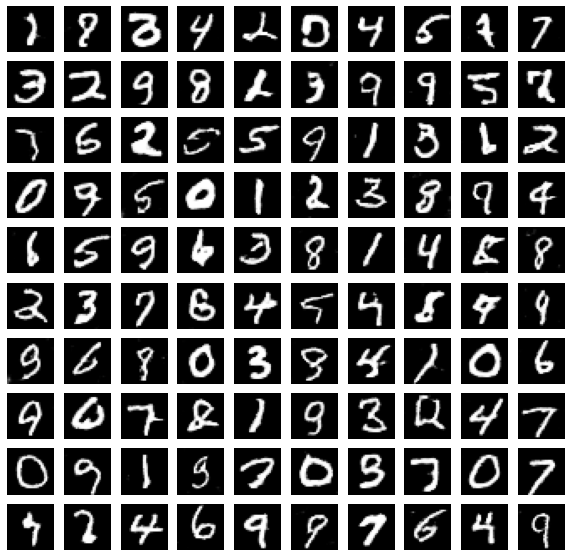

Time for epoch 99 is 17.66842222213745 sec


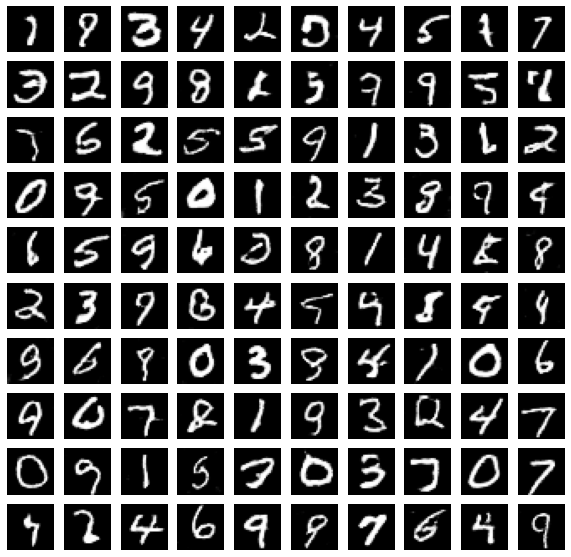

Time for epoch 100 is 17.607232093811035 sec


NameError: ignored

In [27]:
EPOCHS = 100
train(train_dataset, EPOCHS)